In [18]:
# Steady    Burguers  CG  nonlinear
# Unsteady  Burguers  CG  linear      SUPG
# Unsteady  Heat      CG  linear
# Unsteady  Heat      CG  nonlinear
# Unsteady  Burguers  CG  nonlinear
# Unsteady  Wave      CG  nonlinear
# Unsteady  Heat      CG  linear      adaptive mesh refinement
# Unsteady  Heat      CG  nonlinear   adaptive mesh refinement	             All the parameters for adaptivity
# Unsteady  Heat      CG  linear      assembled individually
# Unsteady  Heat      CG  linear      assembled system
# Steady    Stokes    CG  linear      projection of the analytical answer
# Unsteady  Burguers  CG  linear      SUPG                                   For different degrees of freedom
# Steady    Poisson   CG  linear      general solver function
# Steady    Poisson   CG  nonlinear   general solver function		     With vertex values
# Steady    Poisson   CG  nonlinear   general solver function		     With all the parameters
# Steady    Elasticity CG linear/nonlinear PETSC/TAO solvers		     bounded constraints / assembled     
# Steady    Poisson   CG  linear      KrylovSolver			     assembled with parameters       null vector
# Steady    Poisson   CG  linear      KrylovSolver			     assembled with parameters       SIMPLE
# Steady    Heat   CG  nonlinear      			     assembled with parameters       SIMPLE NewtonSolver  Manually
# Steady    Poisson   CG  nonlinear      			     assembled with parameters       SIMPLE NewtonSolver  Manually    2D
# Steady    Poisson   CG  nonlinear      			     assembled with parameters       SIMPLE NewtonSolver  Manually    1D
# Steady    Poisson   CG  nonlinear      KrylovSolver			     assembled with parameters       SIMPLE
# Poisson DG 2D
# Poisson DG 1D
# DG 2D Poisson with constant f,g,u0
# DG Advection difussion linear


Computing eigenvalues. This can take a minute.
Largest eigenvalue:  39.18985947229004


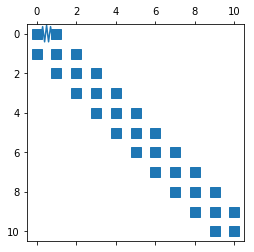

In [2]:
# https://fenicsproject.org/qa/8680/solving-generalized-eigenvalues-finite-element-stiff-matrix/
    
import matplotlib.pyplot as plt
import scipy.sparse as sparse
import numpy as np

from scipy.sparse import csr_matrix
from dolfin import *

# Test for PETSc and SLEPc
if not has_linear_algebra_backend("PETSc"):
    print("DOLFIN has not been configured with PETSc. Exiting.")
    exit()

if not has_slepc():
    print("DOLFIN has not been configured with SLEPc. Exiting.")
    exit()

xmin =  0.0
xmax =  1.0

c      = 1.0
mu     = 0.001

nx     = 10 # no. of elements
p = 2  # degree of FEM
T      = 5  # final time

mesh = IntervalMesh(nx, xmin, xmax)

V = FunctionSpace(mesh, "Lagrange", 1)

# Define basis and bilinear form
u = TrialFunction(V)
v = TestFunction(V)
a = dot(grad(u), grad(v))*dx

# Assemble stiffness form
A = PETScMatrix()
assemble(a, tensor=A)

# Create eigensolver
eigensolver = SLEPcEigenSolver(A)

# Compute all eigenvalues of A x = \lambda x
print("Computing eigenvalues. This can take a minute.")
eigensolver.solve()

# Extract largest (first) eigenpair
r, c, rx, cx = eigensolver.get_eigenpair(0)

print("Largest eigenvalue: ", r)

# Initialize function and assign eigenvector
u = Function(V)
u.vector()[:] = rx

# Plot eigenfunction
plot(u)
# plt.show()

A_mat = as_backend_type(A).mat()
# print(A_mat)

# np.savetxt("stiffnessmatrix.txt", A.array()) To save the matrix
# https://cmdlinetips.com/2019/02/how-to-visualize-sparse-matrix-in-python/

A_sparray = csr_matrix(A_mat.getValuesCSR()[::-1], shape = A_mat.size)

# print(A_sparray)
plt.spy(A_sparray)


In [6]:
# https://fenicsproject.org/qa/8680/solving-generalized-eigenvalues-finite-element-stiff-matrix/
    
import matplotlib.pyplot as plt
import scipy.sparse as sparse
import numpy as np

from scipy.sparse import csr_matrix
from dolfin import *

# Test for PETSc and SLEPc
if not has_linear_algebra_backend("PETSc"):
    print("DOLFIN has not been configured with PETSc. Exiting.")
    exit()

if not has_slepc():
    print("DOLFIN has not been configured with SLEPc. Exiting.")
    exit()

xmin =  0.0
xmax =  1.0

c      = 1.0
mu     = 0.001

nx     = 10 # no. of elements
p = 2  # degree of FEM
T      = 5  # final time

mesh = IntervalMesh(nx, xmin, xmax)

V = FunctionSpace(mesh, "Lagrange", 1)

# Define basis and bilinear form
u = TrialFunction(V)
v = TestFunction(V)
f = Expression("10.0*x[0]*(1.0-x[0])*sin(x[0])", degree=p)

a = (-0.5*u**2*v.dx(0) + inner(grad(u), grad(v)))*dx 
l = f*v*dx

In [ ]:

# Assemble stiffness form
M = PETScMatrix()
assemble(l, tensor=M)


      Calling FFC just-in-time (JIT) compiler, this may take some time.


In [ ]:
A = PETScMatrix()
assemble(a, tensor=A)

# Create eigensolver
eigensolver = SLEPcEigenSolver(A)

# Compute all eigenvalues of A x = \lambda x
print("Computing eigenvalues. This can take a minute.")
eigensolver.solve()

# Extract largest (first) eigenpair
r, c, rx, cx = eigensolver.get_eigenpair(0)

print("Largest eigenvalue: ", r)

# Initialize function and assign eigenvector
u = Function(V)
u.vector()[:] = rx

# Plot eigenfunction
plot(u)
# plt.show()

A_mat = as_backend_type(A).mat()
# print(A_mat)

# np.savetxt("stiffnessmatrix.txt", A.array()) To save the matrix
# https://cmdlinetips.com/2019/02/how-to-visualize-sparse-matrix-in-python/

A_sparray = csr_matrix(A_mat.getValuesCSR()[::-1], shape = A_mat.size)

# print(A_sparray)
plt.spy(A_sparray)

In [ ]:
# Steady    Burguers  CG  nonlinear

"""
STEADY BURGUERS EQUATION CG
This demo program solves Poisson's equation
    (u^2/2)_x - u_xx = f(x)
on the unit interval with source f given by
    f(x) = 9*pi^2*sin(3*pi*x[0])
and boundary conditions given by
    u(0) = u(1) = 0
"""

import time
from dolfin import *
import matplotlib.pyplot as plt
import numpy as np

# Create mesh
mesh = UnitIntervalMesh(50)

# save mesh
File("burguers_steady_CG_nonlinear/mesh.xml") << mesh

"""
STEADY BURGUERS EQUATION
This demo program solves Poisson's equation
    (u^2/2)_x - u_xx = f(x)
on the unit interval with source f given by
    f(x) = 9*pi^2*sin(3*pi*x[0])
and boundary conditions given by
    u(0) = u(1) = 0
"""
import time
from dolfin import *
import matplotlib.pyplot as plt

# Form compiler options
parameters["form_compiler"]["optimize"]     = True
parameters["form_compiler"]["cpp_optimize"] = True
#parameters["form_compiler"]["representation"] = "quadrature"
#parameters["form_compiler"]["quadrature_degree"] = 8
# Read mesh
mesh = Mesh("burguers_steady_CG_nonlinear/mesh.xml")

p=1
# FE function space
V    = FunctionSpace(mesh, "CG", p)

# Sub domain for Dirichlet boundary condition
def DirichletBoundary(x):
     return x[0] < DOLFIN_EPS or x[0] > 1.0 - DOLFIN_EPS

# Define variational problem
f = Expression("10.0*x[0]*(1.0-x[0])*sin(x[0])", degree=p)
#g = grad(f)

v  = TestFunction(V)
u  = Function(V, name="Variables at current step")
du = TrialFunction(V)

#F = (-0.5*u**2*v.dx(0) + inner(grad(u), grad(v)))*dx - f*v*dx
formA = dot(grad(u), grad(v))*dx
forml = f*v*dx
F = formA - forml

A = PETScMatrix()
assemble(formA, tensor=A)

In [ ]:

# A = assemble(formA)
# A_mat = as_backend_type(A).mat()

dF = derivative(F, u, du)

# Define boundary condition
u0 = Constant(0.0)
bc = DirichletBC(V, u0, DirichletBoundary)

# Solve PDE

problem = NonlinearVariationalProblem(F,u,bcs=bc,J=dF)
solver = NonlinearVariationalSolver(problem)
prm = solver.parameters

# Define solver parameters
info(prm, True)
prm['nonlinear_solver'] = 'newton'
prm['newton_solver']['linear_solver'] = 'umfpack'
prm['newton_solver']['report'] = True
prm['newton_solver']['absolute_tolerance'] = 1E-8
prm['newton_solver']['relative_tolerance'] = 1E-7
prm['newton_solver']['maximum_iterations'] = 25
prm['newton_solver']['relaxation_parameter'] = 1.0
prm['newton_solver']['convergence_criterion'] = 'incremental'
#prm['newton_solver']['error_on_nonconvergence'] = True
#prm['newton_solver']['lu_solver']['report'] = False
#prm['newton_solver']['lu_solver']['same_nonzero_pattern']=True    
solver.solve()

# List timings; average across processes in parallel
list_timings(TimingClear.keep, [TimingType.wall, TimingType.system])

# Get Table object with timings
t = timings(TimingClear.keep,
            [TimingType.wall, TimingType.user, TimingType.system])

# Use different MPI reductions
t_sum = MPI.sum(MPI.comm_world, t)
t_min = MPI.min(MPI.comm_world, t)
t_max = MPI.max(MPI.comm_world, t)
t_avg = MPI.avg(MPI.comm_world, t)

# Print aggregate timings to screen
print('\n'+t_sum.str(True))
print('\n'+t_min.str(True))
print('\n'+t_max.str(True))
print('\n'+t_avg.str(True))

# Store to XML file on rank 0
if MPI.rank(MPI.comm_world) == 0:
    f = File(MPI.comm_self, "timings_aggregate.xml")
    f << t_sum
    f << t_min
    f << t_max
    f << t_avg

# Plot solution and solution gradient
plt.figure()
plot(u, title="Solution")

plt.figure()
plot(grad(u), title="Solution gradient")

plt.show()

# Save solution in VTK format
ufile_pvd = File("burguers_steady_CG_nonlinear/u.pvd")
ufile_pvd << u

file = File("burguers_steady_CG_nonlinear/parameters.xml")
file << parameters

File('burguers_steady_CG_nonlinear/parameters.xml') << parameters

# Show time of the program's execution
start_time = time.time()

if __name__ == '__main__':
    print(" %s seconds " % (time.time() - start_time))

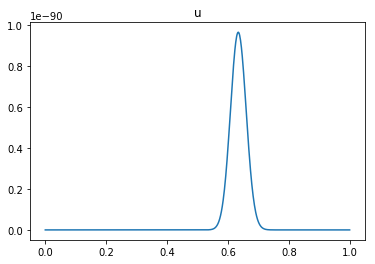

 time of the program's execution: 3.552436828613281e-05 seconds 


In [4]:
# Unsteady  Burguers  CG  linear      SUPG

"""
UNSTEADY BURGUERS EQUATION SUPG
Solution of convection-diffusion equation using SUPG and Crank-Nicholson 
PDE: u_t + c u_x = mu u_xx in (-1,+1)
IC : u(x,0) = -sin(pi*x)
BC : DIRICHLET
"""

from dolfin import *
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
import time




xmin =  0.0
xmax =  1.0

c      = 1.0
mu     = 0.001

nx     = 700 # no. of elements
p = 2  # degree of FEM
T      = 5  # final time

mesh = IntervalMesh(nx, xmin, xmax)
h    = CellDiameter(mesh)


# save mesh
File("burguers_unsteady_SUPG_linear/mesh.xml") << mesh

# Form compiler options
parameters["form_compiler"]["optimize"]     = True
parameters["form_compiler"]["cpp_optimize"] = True
#parameters["form_compiler"]["representation"] = "quadrature"
#parameters["form_compiler"]["quadrature_degree"] = 8

hmin = mesh.hmin()
dt   = min(hmin/c, hmin**2/mu)

# Sub domain for Dirichlet boundary condition
def DirichletBoundary(x):
     return x[0] < DOLFIN_EPS or x[0] > 1.0 - DOLFIN_EPS
    
V = FunctionSpace(mesh, "CG", p)

u = Function(V)
uo= Function(V)
v = TrialFunction(V)
w = TestFunction(V)

uinit = Expression("3*x[0]", degree=p) #-sin(pi*x[0])
u = interpolate(uinit, V)

ut = 0.5*(uo + v)
tau= h/(2*abs(c))
s  = mu*Dx(ut,0)

F =   (1/dt)*(v-uo)*w*dx \
    + c*Dx(ut,0)*w*dx             \
    + mu*Dx(ut,0)*Dx(w,0)*dx      \
    - mu*Dx(ut,0)*w*ds(1) + mu*Dx(ut,0)*w*ds(0) \
    + c*Dx(w,0)*tau*((v-uo)/dt + c*Dx(ut,0) - Dx(s,0))*dx

a = lhs(F)
L = rhs(F)

# Define boundary condition
u0 = Constant(0.0)
bc = DirichletBC(V, u0, DirichletBoundary)

ff = File("burguers_unsteady_SUPG_linear/u.pvd", "compressed")
ff << u

t = 0
it= 0
while t < T:
   # Adjust dt so that we exactly reach T
   if t+dt > T:
      dt = T - t
   uo.assign(u)
   solve(a == L, u, bc)
   t = t + dt
   it= it + 1
   #print("Iter=", it, ", t=", t)
   ff << u
    
plt.figure()
plot(u, title='u')

# Hold plot
plt.show()

# Show time of the program's execution
start_time = time.time()
if __name__ == '__main__':
    print(" time of the program's execution: %s seconds " % (time.time() - start_time))

Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.


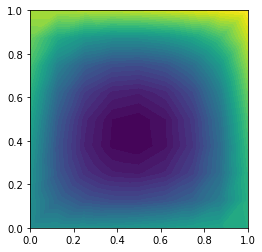

In [1]:
# Unsteady  Heat      CG  linear

"""
FEniCS tutorial demo program: Heat equation with Dirichlet conditions.
Test problem is chosen to give an exact solution at all nodes of the mesh.

  u'= Laplace(u) + f  in the unit square
  u = u_D             on the boundary
  u = u_0             at t = 0

  u = 1 + x^2 + alpha*y^2 + \beta*t
  f = beta - 2 - 2*alpha
"""

from __future__ import print_function
import matplotlib.pyplot as plt
from fenics import *
import numpy as np


# Form compiler options
parameters["form_compiler"]["optimize"]     = True
parameters["form_compiler"]["cpp_optimize"] = True
#parameters["form_compiler"]["representation"] = "quadrature"
#parameters["form_compiler"]["quadrature_degree"] = 8

T = 10.0            # final time
num_steps = 500     # number of time steps
dt = T / num_steps # time step size
alpha = 3          # parameter alpha
beta = 1.2         # parameter beta

# Create mesh and define function space
nx = ny = 8
mesh = UnitSquareMesh(nx, ny)
p=2

# save mesh
File("heat_unsteady_CG_linear/mesh.xml") << mesh

V = FunctionSpace(mesh, 'P', p)

# Define boundary condition
u_D = Expression('1 + x[0]*x[0] + alpha*x[1]*x[1] + beta*t',
                 degree=p, alpha=alpha, beta=beta, t=0)

def boundary(x, on_boundary):
    return on_boundary

bc = DirichletBC(V, u_D, boundary)

# Define initial value
u_n = interpolate(u_D, V)
#u_n = project(u_D, V)

# Define variational problem
u = TrialFunction(V)
v = TestFunction(V)
f = Constant(beta - 2 - 2*alpha)*u

F = u*v*dx + dt*dot(grad(u), grad(v))*dx - (u_n + dt*f)*v*dx
a, L = lhs(F), rhs(F)

# Time-stepping
u = Function(V)

ff = File("heat_unsteady_CG_linear/u.pvd", "compressed")
ff << u

t = 0
for n in range(num_steps):

    # Update current time
    t += dt
    u_D.t = t

    # Compute solution
    solve(a == L, u, bc)

    # Plot solution
    plot(u)

    # Update previous solution
    u_n.assign(u)
    
    ff << u



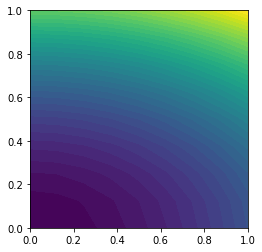

In [6]:
# Unsteady  Heat      CG  nonlinear

"""
FEniCS tutorial demo program: Heat equation with Dirichlet conditions.
Test problem is chosen to give an exact solution at all nodes of the mesh.

  u'= Laplace(u) + f  in the unit square
  u = u_D             on the boundary
  u = u_0             at t = 0

  u = 1 + x^2 + alpha*y^2 + \beta*t
  f = beta - 2 - 2*alpha
"""

from __future__ import print_function
import matplotlib.pyplot as plt
from fenics import *
import numpy as np


# Form compiler options
parameters["form_compiler"]["optimize"]     = True
parameters["form_compiler"]["cpp_optimize"] = True
#parameters["form_compiler"]["representation"] = "quadrature"
#parameters["form_compiler"]["quadrature_degree"] = 8

T = 2.0            # final time
num_steps = 10     # number of time steps
dt = T / num_steps # time step size
alpha = 3          # parameter alpha
beta = 1.2         # parameter beta

# Create mesh and define function space
nx = ny = 8
mesh = UnitSquareMesh(nx, ny)
p=2

# save mesh
File("heat_unsteady_CG_nonlinear/mesh.xml") << mesh

V = FunctionSpace(mesh, 'P', p)

# Define boundary condition
u_D = Expression('1 + x[0]*x[0] + alpha*x[1]*x[1] + beta*t',
                 degree=p, alpha=alpha, beta=beta, t=0)

def boundary(x, on_boundary):
    return on_boundary

bc = DirichletBC(V, u_D, boundary)

# Define initial value
u_n = interpolate(u_D, V)
#u_n = project(u_D, V)

# Define variational problem
u = Function(V)
v = TestFunction(V)
f = Constant(beta - 2 - 2*alpha)

du = TrialFunction(V)

F = u*v*dx + dt*dot(grad(u), grad(v))*dx - (u_n + dt*f)*v*dx
#a, L = lhs(F), rhs(F)

# Time-stepping
dF= derivative(F, u, du)

ff = File("heat_unsteady_CG_nonlinear/u.pvd", "compressed")
ff << u

t = 0
for n in range(num_steps):

    # Update current time
    t += dt
    u_D.t = t

    # Compute solution
    problem = NonlinearVariationalProblem(F,u,bcs=bc,J=dF)
    solver = NonlinearVariationalSolver(problem)
    prm = solver.parameters

    # Define solver parameters
    #info(prm, True)
    #prm['nonlinear_solver'] = 'newton'
    #prm['newton_solver']['linear_solver'] = 'umfpack'
    #prm['newton_solver']['report'] = True
    #prm['newton_solver']['absolute_tolerance'] = 1E-10
    #prm['newton_solver']['relative_tolerance'] = 1E-10
    #prm['newton_solver']['maximum_iterations'] = 25
    #prm['newton_solver']['relaxation_parameter'] = 1.0
    #prm['newton_solver']['convergence_criterion'] = 'incremental'
    #prm['newton_solver']['convergence_criterion'] = 'residual'
    #prm['newton_solver']['error_on_nonconvergence'] = True
    #prm['newton_solver']['lu_solver']['report'] = False
    #prm['newton_solver']['lu_solver']['same_nonzero_pattern']=True    
    solver.solve()

    # Plot solution
    plot(u)

    # Update previous solution
    u_n.assign(u)
    
    ff << u



Iteration : 1400.0 of 1400
Time      : 1.9999999999998685 s


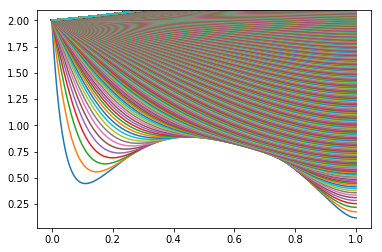

Time of the program's execution: 3.647804260253906e-05 seconds 


In [7]:
# Unsteady  Burguers  CG  nonlinear

"""
UNSTEADY BURGUERS EQUATION
Solution of convection-diffusion equation using CG and backward Euler method
PDE: u_t + c u_x = mu u_xx in (-1,+1)
IC : u(x,0) = -sin(pi*x)
BC : DIRICHLET
"""

from __future__ import print_function
from IPython.display import clear_output
from fenics import *
import matplotlib.pyplot as plt
import numpy as np
import time

# Form compiler options
parameters["form_compiler"]["optimize"]     = True
parameters["form_compiler"]["cpp_optimize"] = True
#parameters["form_compiler"]["representation"] = "quadrature"
#parameters["form_compiler"]["quadrature_degree"] = 8

# Define constants
c   = 1.0
mu  = 0.001
ubc = 2.0

# Define space discretization properties
xmin = 0.0
xmax = 1.0
nx   = 700 # no. of elements
p    = 2  # degree of FEM
mesh = IntervalMesh(nx, xmin, xmax)
h    = CellDiameter(mesh)
hmin = mesh.hmin()

# Save mesh
File("burguers_unsteady_CG_nonlinear/mesh.xml") << mesh

# Define time discretization properties
T         = 2.0            # final time
dt        = min(hmin / c, hmin**2 / mu)
num_steps = round(T / dt)

# Define funcion spaces
V  = FunctionSpace(mesh, "CG", p)

# Define test and trial functions
v  = TestFunction(V)
u  = Function(V, name = "Variables at current step")
du = TrialFunction(V)

# Define initial condition
u_ic = Expression("sin(pi*x[0])", degree=p)
u_n  = interpolate(u_ic, V)

# Define boundary condition
u_bc = Expression("ubc", degree=p, ubc = ubc)

# Sub domain for Dirichlet boundary condition
def right(x, on_boundary): 
    return x[0] > (1.0 - DOLFIN_EPS)
def left(x, on_boundary): 
    return x[0] < DOLFIN_EPS

bc = DirichletBC(V, u_bc, left)

# Define expressions used in weak form
k = Expression("dt", degree = p, dt = dt)
f = Expression("10.0*x[0]*(1.0-x[0])*sin(x[0])", degree = p)

# Define weak form
F = ((u - u_n) / k)*v*dx + (u*v*Dx(u,0) + inner(grad(u), grad(v)))*dx - f*v*dx

# Define Jacobian
dF = derivative(F, u, du)

# Define files
ff = File("burguers_unsteady_CG_nonlinear/u.pvd", "compressed")
#ff << u #to see what happens since the t=0, write u_n

# Iterative process
t = 0
for n in range(num_steps):

    # Update current time
    t += dt
    #u_D.t = t
    
    # Print progress
    clear_output()
    print("Iteration :", t/dt, "of", num_steps)
    print("Time      :", t, "s")
    
    # Compute solution
    problem = NonlinearVariationalProblem(F, u, bcs = bc, J = dF)
    solver  = NonlinearVariationalSolver(problem)
    prm     = solver.parameters

    # Define solver parameters
    #info(prm, True)
    prm['nonlinear_solver']                                    = 'newton'
    prm['newton_solver']['linear_solver']                      = 'umfpack'
    #prm['newton_solver']['report']                            = True
    #prm['newton_solver']['absolute_tolerance']                = 1E-10
    #prm['newton_solver']['relative_tolerance']                = 1E-10
    #prm['newton_solver']['maximum_iterations']                = 25
    #prm['newton_solver']['relaxation_parameter']              = 1.0
    #prm['newton_solver']['convergence_criterion']             = 'incremental'
    #prm['newton_solver']['convergence_criterion']             = 'residual'
    #prm['newton_solver']['error_on_nonconvergence']           = True
    #prm['newton_solver']['lu_solver']['report']               = False
    #prm['newton_solver']['lu_solver']['same_nonzero_pattern'] = True    
    solver.solve()

    # Plot solution
    plot(u)

    # Update previous solution
    u_n.assign(u)
    
    # Save solution
    ff << u

# Hold plot
plt.show()

# Show time of the program's execution
start_time  = time.time()
if __name__ == '__main__':
    print("Time of the program's execution: %s seconds " % (time.time() - start_time))

Iteration : 200.00000000000014 of 200
Time      : 2.0000000000000013 s


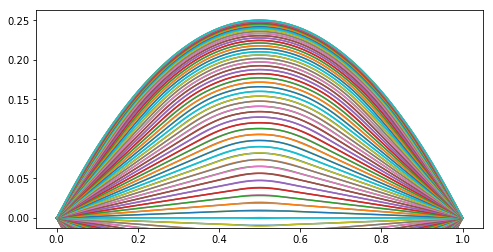

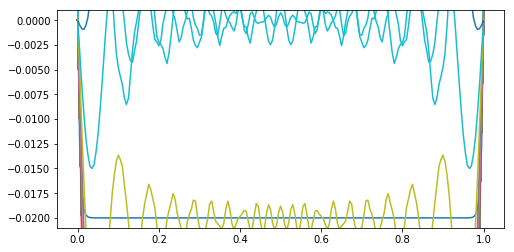

Time of the program's execution: 4.076957702636719e-05 seconds 


In [9]:
# Unsteady  Wave      CG  nonlinear

"""
WAVE PDE SYSTEM
Solution of convection-diffusion equation using CG and backward Crank Nicholson
PDE: 
IC : 
BC : DIRICHLET

https://fenicsproject.discourse.group/t/aritymismatch-for-crank-nicolson-method-on-mixed-function-space/781/3
"""

from __future__ import print_function
from IPython.display import clear_output
from fenics import *
import matplotlib.pyplot as plt
import numpy as np
import time

# Form compiler options
parameters ["form_compiler"]["optimize"]          = True
parameters ["form_compiler"]["cpp_optimize"]      = True
#parameters["form_compiler"]["representation"] = "quadrature"
parameters ["form_compiler"]["quadrature_degree"] = 2

parameters ["form_compiler"]["cpp_optimize"]      = True
ffc_options = {"optimize": True, \
               "eliminate_zeros": True, \
               "precompute_basis_const": True, \
               "precompute_ip_const": True}

# Define constants
c     = 1.0
mu    = 0.001
u1bc1 = 0.0
u1bc2 = 0.0
u2bc1 = 0.0
u2bc2 = 0.0

# Define space discretization properties
xmin = 0.0
xmax = 1.0
nx   = 200 # no. of elements
p    = 1  # degree of FEM
mesh = IntervalMesh (nx, xmin, xmax)
h    = CellDiameter (mesh)
hmin = mesh.hmin ()

# Save mesh
File ("wave2PDEs_unsteady_CG_nonlinear/mesh.xml") << mesh

# Define time discretization properties
T         = 2.0            # final time
num_steps = 200
dt        = T / num_steps

# Define funcion spaces
V1      = FiniteElement ('Lagrange', mesh.ufl_cell(), degree=p)
V2      = FiniteElement ('Lagrange', mesh.ufl_cell(), degree=p)
element = MixedElement ([V1, V2])
V       = FunctionSpace (mesh, element)

# Define test and trial functions
v1, v2     = TestFunctions (V)

u          = Function (V, name = "Variables at current step")
u1, u2     = split (u)

du         = TrialFunction (V)

# Define initial condition
class InitialConditions (UserExpression):
    def __init__ (self, **kwargs):
        super (InitialConditions, self).__init__(**kwargs)
    def eval (self, values, x):
        values[0] = x[0] * (1 - x[0])
        values[1] = 0.0
    def value_shape (self):
        return (2,)

u_ic       = InitialConditions(degree = p)
u_n        = interpolate (u_ic, V) 
u_n1, u_n2 = split (u_n)

# Define boundary condition
u1_bc1 = Expression ("u1bc1", degree = p, u1bc1 = u1bc1)
u1_bc2 = Expression ("u1bc2", degree = p, u1bc2 = u1bc2)
u2_bc1 = Expression ("u2bc1", degree = p, u2bc1 = u2bc1)
u2_bc2 = Expression ("u2bc2", degree = p, u2bc2 = u2bc2)

# Sub domain for Dirichlet boundary condition
def right (x, on_boundary): 
    return x[0] > (1.0 - DOLFIN_EPS)
def left (x, on_boundary): 
    return x[0] < DOLFIN_EPS

bc1 = DirichletBC(V.sub (0), u1_bc1, left)
bc2 = DirichletBC(V.sub (0), u1_bc2, right)
bc3 = DirichletBC(V.sub (1), u2_bc1, left)
bc4 = DirichletBC(V.sub (1), u2_bc2, right)
bcs = [bc1, bc2, bc3, bc4]

# Define expressions used in weak form
k = Expression ("dt", degree = p, dt = dt)
c = Expression ("c", degree = p, c = c)

# Define weak form
F = u1*v1*dx - 0.5*k*u2*v1*dx - (u_n1*v1*dx + 0.5*k*u_n2*v1*dx) +\
u2*v2*dx + 0.5*c**2*k*inner(grad(u1), grad(v2))*dx - (u_n2*v2*dx - 0.5*c**2*k*inner(grad(u_n1), grad(v2))*dx)

# Define Jacobian
dF = derivative (F, u, du)

# Define files
ff1 = File ("wave2PDEs_unsteady_CG_nonlinear/u1.pvd", "compressed")
ff2 = File ("wave2PDEs_unsteady_CG_nonlinear/u2.pvd", "compressed")

# Iterative process
t = 0
for n in range (num_steps):

    # Update current time
    t += dt
    #u_D.t = t
    
    # Print progress
    clear_output ()
    print("Iteration :", t/dt, "of", num_steps)
    print("Time      :", t, "s")
    
    # Compute solution
    problem = NonlinearVariationalProblem (F, u, bcs = bcs, J = dF)
    solver  = NonlinearVariationalSolver (problem)
    prm     = solver.parameters

    # Define solver parameters
    #info(prm, True)
    
    prm = solver.parameters
    prm ['newton_solver']['report']                  = True
    prm ['newton_solver']['absolute_tolerance']      = 1E-8
    prm ['newton_solver']['relative_tolerance']      = 1E-7
    prm ['newton_solver']['maximum_iterations']      = 50
    prm ['newton_solver']['relaxation_parameter']    = 1.0
    prm ['newton_solver']['convergence_criterion']   = 'incremental' #'residual'
    prm ['newton_solver']['error_on_nonconvergence'] = True
    
    prm ['newton_solver']['linear_solver']                        = 'gmres'
    prm ['newton_solver']['preconditioner']                       = 'ilu'
    prm ['newton_solver']['lu_solver']['report']                  = False
    prm ['newton_solver']['krylov_solver']['absolute_tolerance']  = 1E-9
    prm ['newton_solver']['krylov_solver']['relative_tolerance']  = 1E-7
    prm ['newton_solver']['krylov_solver']['maximum_iterations']  = 10000
    prm ['newton_solver']['krylov_solver']["monitor_convergence"] = True
    
    #prm['newton_solver']['krylov_solver']['gmres']['restart'] = 40
    #prm['newton_solver']['krylov_solver']['preconditioner']['ilu']['fill_level'] = 0
    #prm['newton_solver']['lu_solver']['same_nonzero_pattern'] = True   
    
    #prm['nonlinear_solver']='snes'
    #prm['snes_solver']['absolute_tolerance']=1e-6
    #prm['snes_solver']['maximum_iterations']=2000

    solver.solve ()
    
    (u1,u2) = u.split (deepcopy = True)
    
    # Plot solution
    plt.figure (1, figsize = (8, 4))
    #plt.clf()
    plot (u1) #Plot from -0.3 to 0.3
    
    plt.figure (2, figsize = (8, 4))
    #plt.clf()
    plot (u2)
    
    # Update previous solution
    u_n.assign (u)
    
    # Save solution
    ff1 << u1
    ff2 << u2

# Hold plot
plt.show () 

# Show time of the program's execution
start_time  = time.time ()
if __name__ == '__main__':
    print("Time of the program's execution: %s seconds " % (time.time () - start_time))

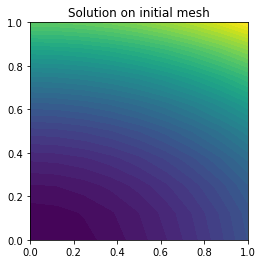

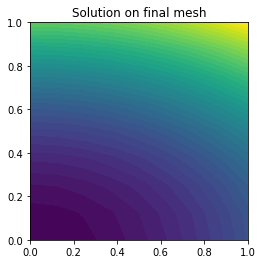

In [10]:
# Unsteady  Heat      CG  linear      adaptive mesh refinement

"""
FEniCS tutorial demo program: Heat equation with Dirichlet conditions.
Test problem is chosen to give an exact solution at all nodes of the mesh.

  u'= Laplace(u) + f  in the unit square
  u = u_D             on the boundary
  u = u_0             at t = 0

  u = 1 + x^2 + alpha*y^2 + \beta*t
  f = beta - 2 - 2*alpha
"""

from __future__ import print_function
import matplotlib.pyplot as plt
from fenics import *
import numpy as np


# Form compiler options
parameters["form_compiler"]["optimize"]     = True
parameters["form_compiler"]["cpp_optimize"] = True
#parameters["form_compiler"]["representation"] = "quadrature"
#parameters["form_compiler"]["quadrature_degree"] = 8

T = 2.0            # final time
num_steps = 10     # number of time steps
dt = T / num_steps # time step size
alpha = 3          # parameter alpha
beta = 1.2         # parameter beta

# Create mesh and define function space
nx = ny = 8
mesh = UnitSquareMesh(nx, ny)
p=2

# save mesh
File("heat_unsteady_CG_linear_adaptive/mesh.xml") << mesh

V = FunctionSpace(mesh, 'P', p)

# Define boundary condition
u_D = Expression('1 + x[0]*x[0] + alpha*x[1]*x[1] + beta*t',
                 degree=p, alpha=alpha, beta=beta, t=0)

def boundary(x, on_boundary):
    return on_boundary

bc = DirichletBC(V, u_D, boundary)

# Define initial value
u_n = interpolate(u_D, V)
#u_n = project(u_D, V)

# Define variational problem
u = TrialFunction(V)
v = TestFunction(V)
f = Constant(beta - 2 - 2*alpha)

F = u*v*dx + dt*dot(grad(u), grad(v))*dx - (u_n + dt*f)*v*dx
a, L = lhs(F), rhs(F)

# Time-stepping
u = Function(V)


# Define goal functional (quantity of interest)
M = u*dx()

# Define error tolerance
tol = 1.e-5

ff = File("heat_unsteady_CG_linear_adaptive/u.pvd", "compressed")
ff << u

t = 0
for n in range(num_steps):

    # Update current time
    t += dt
    u_D.t = t

    # Compute solution
    problem = LinearVariationalProblem(a, L, u, bc)
    solver = AdaptiveLinearVariationalSolver(problem, M)
    solver.parameters["error_control"]["dual_variational_solver"]["linear_solver"] = "cg"
    solver.parameters["error_control"]["dual_variational_solver"]["symmetric"] = True
    solver.solve(tol)

    solver.summary()

    # Update previous solution
    u_n.assign(u)
    
    ff << u

# Plot solution(s)
plt.figure()
plot(u.root_node(), title = "Solution on initial mesh")
plt.figure()
plot(u.leaf_node(), title = "Solution on final mesh")
plt.show()

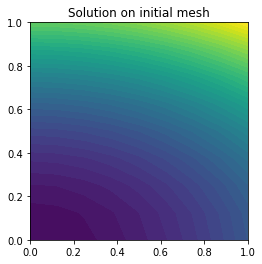

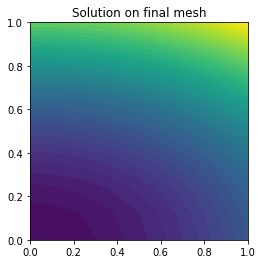

Time of the program's execution: 3.7670135498046875e-05 seconds 


In [18]:
# Unsteady  Heat      CG  nonlinear   adaptive mesh refinement	             All the parameters for adaptivity
"""
FEniCS tutorial demo program: Heat equation with Dirichlet conditions.
Test problem is chosen to give an exact solution at all nodes of the mesh.

  u'= Laplace(u) + f  in the unit square
  u = u_D             on the boundary
  u = u_0             at t = 0

  u = 1 + x^2 + alpha*y^2 + \beta*t
  f = beta - 2 - 2*alpha
"""

from __future__ import print_function
import matplotlib.pyplot as plt
from fenics import *
import numpy as np


# Form compiler options
parameters["form_compiler"]["optimize"]     = True
parameters["form_compiler"]["cpp_optimize"] = True
#parameters["form_compiler"]["representation"] = "quadrature"
#parameters["form_compiler"]["quadrature_degree"] = 8

T = 2.0            # final time
num_steps = 10     # number of time steps
dt = T / num_steps # time step size
alpha = 3          # parameter alpha
beta = 1.2         # parameter beta

# Create mesh and define function space
nx = ny = 8
mesh = UnitSquareMesh(nx, ny)
p=2

# save mesh
File("heat_unsteady_CG_nonlinear_adaptive/mesh.xml") << mesh

V = FunctionSpace(mesh, 'P', p)

# Define boundary condition
u_D = Expression('1 + x[0]*x[0] + alpha*x[1]*x[1] + beta*t',
                 degree=p, alpha=alpha, beta=beta, t=0)

def boundary(x, on_boundary):
    return on_boundary

bc = DirichletBC(V, u_D, boundary)

# Define initial value
u_n = interpolate(u_D, V)
#u_n = project(u_D, V)

# Define variational problem
u = Function(V)
v = TestFunction(V)
f = Constant(beta - 2 - 2*alpha)

du = TrialFunction(V)

F = u*v*dx + dt*dot(grad(u), grad(v))*dx - (u_n + dt*f)*v*dx
#a, L = lhs(F), rhs(F)

# Define goal functional (quantity of interest)
M = u*dx()

# Define error tolerance
tol = 1.e-3

# Time-stepping
dF= derivative(F, u, du)

ff = File("heat_unsteady_CG_nonlinear_adaptive/u.pvd", "compressed")
ff << u

t = 0
for n in range(num_steps):

    # Update current time
    t += dt
    u_D.t = t

    # Compute solution
    problem = NonlinearVariationalProblem(F, u, bcs = bc, J = dF)
    
    solver = AdaptiveNonlinearVariationalSolver(problem,M)
    prm    = solver.parameters
    
    info(prm, True)
    
    prm ["data_label"] = "adaptivity"
    prm ["marking_fraction"] = 0.5 #(between 0.5 and 1)
    prm ["marking_strategy"] = "dorfler"
    prm ["max_dimension"] = 0
    prm ["max_iterations"] = 50
    #prm ["reference"] = 0 #verificar porque aprarecio 0000
    prm ["save_data"] = True
    
    prm ["error_control"]["dual_variational_solver"]["linear_solver"] = "gmres"
    prm ["error_control"]["dual_variational_solver"]["preconditioner"] = "ilu"
    prm ["error_control"]["dual_variational_solver"]["print_matrix"] = False
    prm ["error_control"]["dual_variational_solver"]["print_rhs"] = False
    prm ["error_control"]["dual_variational_solver"]["symmetric"] = False
    
    prm ['error_control']["dual_variational_solver"]['krylov_solver']['absolute_tolerance']       = 1E-5 #1E-9
    #prm ['error_control']['krylov_solver']['divergence_limit']         = 
    prm ['error_control']["dual_variational_solver"]['krylov_solver']['error_on_nonconvergence']  = True
    prm ['error_control']["dual_variational_solver"]['krylov_solver']['maximum_iterations']       = 1000
    prm ['error_control']["dual_variational_solver"]['krylov_solver']["monitor_convergence"]      = True
    prm ['error_control']["dual_variational_solver"]['krylov_solver']["nonzero_initial_guess"]    = True #False
    prm ['error_control']["dual_variational_solver"]['krylov_solver']['relative_tolerance']       = 1E-3
    prm ['error_control']["dual_variational_solver"]['krylov_solver']['report']                   = True
    
    prm ['error_control']["dual_variational_solver"]['lu_solver']['report']    = False
    prm ['error_control']["dual_variational_solver"]['lu_solver']['symmetric'] = False
    prm ['error_control']["dual_variational_solver"]['lu_solver']['verbose']   = False
    
    prm ['nonlinear_variational_solver']['nonlinear_solver'] = 'newton'
    prm ['nonlinear_variational_solver']['print_matrix']     = False #True
    prm ['nonlinear_variational_solver']['print_rhs']        = False #True
    prm ['nonlinear_variational_solver']['symmetric']        = False #True
    
    prm ['nonlinear_variational_solver']['newton_solver']['absolute_tolerance']      = 1E-8
    prm ['nonlinear_variational_solver']['newton_solver']['convergence_criterion']   = 'incremental' #'residual'
    prm ['nonlinear_variational_solver']['newton_solver']['error_on_nonconvergence'] = True
    prm ['nonlinear_variational_solver']['newton_solver']['linear_solver']           = 'gmres'       #'ml_amg'
    prm ['nonlinear_variational_solver']['newton_solver']['maximum_iterations']      = 25
    prm ['nonlinear_variational_solver']['newton_solver']['preconditioner']          = 'ilu'
    prm ['nonlinear_variational_solver']['newton_solver']['relative_tolerance']      = 1E-8
    prm ['nonlinear_variational_solver']['newton_solver']['relaxation_parameter']    = 1.0
    prm ['nonlinear_variational_solver']['newton_solver']['report']                  = True

    prm ['nonlinear_variational_solver']['newton_solver']['krylov_solver']['absolute_tolerance']       = 1E-5 #1E-9
    #prm ['nonlinear_variational_solver']['newton_solver']['krylov_solver']['divergence_limit']         = 
    prm ['nonlinear_variational_solver']['newton_solver']['krylov_solver']['error_on_nonconvergence']  = True
    prm ['nonlinear_variational_solver']['newton_solver']['krylov_solver']['maximum_iterations']       = 1000
    prm ['nonlinear_variational_solver']['newton_solver']['krylov_solver']["monitor_convergence"]      = True
    prm ['nonlinear_variational_solver']['newton_solver']['krylov_solver']["nonzero_initial_guess"]    = True #False
    prm ['nonlinear_variational_solver']['newton_solver']['krylov_solver']['relative_tolerance']       = 1E-3
    prm ['nonlinear_variational_solver']['newton_solver']['krylov_solver']['report']                   = True
    
    prm ['nonlinear_variational_solver']['newton_solver']['lu_solver']['report']    = False
    prm ['nonlinear_variational_solver']['newton_solver']['lu_solver']['symmetric'] = False
    prm ['nonlinear_variational_solver']['newton_solver']['lu_solver']['verbose']   = False
    
    solver.solve(tol)

    solver.summary()

    # Plot solution
    #plot(u)

    # Update previous solution
    u_n.assign(u)
    
    ff << u

# Plot solution(s)
plt.figure()
plot(u.root_node(), title="Solution on initial mesh")
plt.figure()
plot(u.leaf_node(), title="Solution on final mesh")
plt.show()

  
# Show time of the program's execution
start_time  = time.time ()
if __name__ == '__main__':
    print("Time of the program's execution: %s seconds " % (time.time () - start_time))

In [1]:
# Unsteady  Heat      CG  linear      assembled individually

"""
Unsteady  Heat      CG  linear     Adaptive mesh refinement ASSEMBLED

FEniCS tutorial demo program: Heat equation with Dirichlet conditions.
Test problem is chosen to give an exact solution at all nodes of the mesh.

  u'= Laplace(u) + f  in the unit square
  u = u_D             on the boundary
  u = u_0             at t = 0

  u = 1 + x^2 + alpha*y^2 + \beta*t
  f = beta - 2 - 2*alpha
"""

from __future__ import print_function
import matplotlib.pyplot as plt
from fenics import *
import numpy as np


# Form compiler options
parameters["form_compiler"]["optimize"]     = True
parameters["form_compiler"]["cpp_optimize"] = True
#parameters["form_compiler"]["representation"] = "quadrature"
#parameters["form_compiler"]["quadrature_degree"] = 8

T = 2.0            # final time
num_steps = 10     # number of time steps
dt = T / num_steps # time step size
alpha = 3          # parameter alpha
beta = 1.2         # parameter beta

# Create mesh and define function space
nx = ny = 8
mesh = UnitSquareMesh(nx, ny)
p=2

# save mesh
File("heat_unsteady_CG_linear_adaptive/mesh.xml") << mesh

V = FunctionSpace(mesh, 'P', p)

# Define boundary condition
u_D = Expression('1 + x[0]*x[0] + alpha*x[1]*x[1] + beta*t',
                 degree=p, alpha=alpha, beta=beta, t=0)

def boundary(x, on_boundary):
    return on_boundary

bc = DirichletBC(V, u_D, boundary)

# Define initial value
u_n = interpolate(u_D, V)
#u_n = project(u_D, V)

# Define variational problem
u = TrialFunction(V)
v = TestFunction(V)
f = Constant(beta - 2 - 2*alpha)

F = u*v*dx + dt*dot(grad(u), grad(v))*dx - (u_n + dt*f)*v*dx
a, L = lhs(F), rhs(F)

# Assemble linear system
A = assemble(a)
b = assemble(L)

# Apply boundary conditions
bc.apply(A, b)

# Time-stepping
u = Function(V)

ff = File("heat_unsteady_CG_linear_adaptive/u.pvd", "compressed")
ff << u

t = 0
for n in range(num_steps):

    # Update current time
    t += dt
    u_D.t = t

    # Compute solution
    solver = KrylovSolver('gmres', 'ilu')
    #solver = LUSolver()

    
    solver.solve(A, u.vector(), b)
    
    # Update previous solution
    u_n.assign(u)
    
    ff << u

# Plot solution(s)
plot(u)

Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.


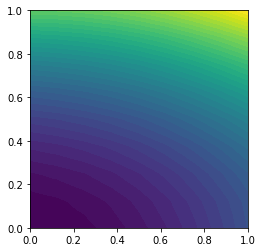

In [20]:
# Unsteady  Heat      CG  linear      assembled system

"""
Unsteady  Heat      CG  linear     Adaptive mesh refinement ASSEMBLED

FEniCS tutorial demo program: Heat equation with Dirichlet conditions.
Test problem is chosen to give an exact solution at all nodes of the mesh.

  u'= Laplace(u) + f  in the unit square
  u = u_D             on the boundary
  u = u_0             at t = 0

  u = 1 + x^2 + alpha*y^2 + \beta*t
  f = beta - 2 - 2*alpha
"""

from __future__ import print_function
import matplotlib.pyplot as plt
from fenics import *
import numpy as np


# Form compiler options
parameters["form_compiler"]["optimize"]     = True
parameters["form_compiler"]["cpp_optimize"] = True
#parameters["form_compiler"]["representation"] = "quadrature"
#parameters["form_compiler"]["quadrature_degree"] = 8

T = 2.0            # final time
num_steps = 10     # number of time steps
dt = T / num_steps # time step size
alpha = 3          # parameter alpha
beta = 1.2         # parameter beta

# Create mesh and define function space
nx = ny = 8
mesh = UnitSquareMesh(nx, ny)
p=2

# save mesh
File("heat_unsteady_CG_linear_adaptive/mesh.xml") << mesh

V = FunctionSpace(mesh, 'P', p)

# Define boundary condition
u_D = Expression('1 + x[0]*x[0] + alpha*x[1]*x[1] + beta*t',
                 degree=p, alpha=alpha, beta=beta, t=0)

def boundary(x, on_boundary):
    return on_boundary

bc = DirichletBC(V, u_D, boundary)

# Define initial value
u_n = interpolate(u_D, V)
#u_n = project(u_D, V)

# Define variational problem
u = TrialFunction(V)
v = TestFunction(V)
f = Constant(beta - 2 - 2*alpha)

F = u*v*dx + dt*dot(grad(u), grad(v))*dx - (u_n + dt*f)*v*dx
a, L = lhs(F), rhs(F)

# Assemble linear system
A, b = assemble_system(a, L, bc)
#b = assemble(L)

# Apply boundary conditions
#bc.apply(A, b)

# Time-stepping
u = Function(V)

ff = File("heat_unsteady_CG_linear_adaptive/u.pvd", "compressed")
ff << u

t = 0
for n in range(num_steps):

    # Update current time
    t += dt
    u_D.t = t

    # Compute solution
    #solver = KrylovSolver('gmres', 'ilu')
    #solver = LUSolver()
    
    solve(A, u.vector(), b, "lu")
    
    # Update previous solution
    u_n.assign(u)
    
    ff << u

# Plot solution(s)
plot(u)

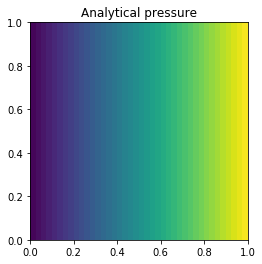

In [21]:
# Steady    Stokes    CG  linear      projection of the analytical answer

from dolfin import *

def u_boundary(x):
    return x[0] < DOLFIN_EPS or x[1] > 1.0 - DOLFIN_EPS or x[1] < DOLFIN_EPS
    
def p_boundary(x):
    return x[0] > 1.0 - DOLFIN_EPS

mesh    = UnitSquareMesh(40,40)
V       = VectorElement ('Lagrange', mesh.ufl_cell(), degree=1)
V1      = FunctionSpace (mesh, V)
Q       = FiniteElement ('Lagrange', mesh.ufl_cell(), degree=1)
Q1      = FunctionSpace (mesh, Q)

element = MixedElement ([V, Q])
W       = FunctionSpace (mesh, element)

u, p = TrialFunctions(W)
v, q = TestFunctions(W)

f = Constant([0,0])

u_analytical = Expression(["x[1]*(1-x[1])", "0.0"], degree=1)
p_analytical = Expression("-2+2*x[0]", degree=1)

bc_u = DirichletBC(W.sub(0), u_analytical, u_boundary)
bc = [bc_u]

a = inner(grad(u), grad(v))*dx + div(u)*q*dx + div(v)*p*dx
L = inner(f, v)*dx

UP = Function(W)
A, b = assemble_system(a, L, bc)
solve(A, UP.vector(), b, "lu")

U, P = UP.split()

# plot(U, title="Numerical velocity")
# plot(P, title="Numerical pressure")

U_analytical = project(u_analytical, V1)
P_analytical = project(p_analytical, Q1)

plot(U_analytical, title="Analytical velocity")
plot(P_analytical, title="Analytical pressure")

#interactive()

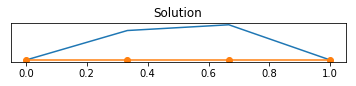

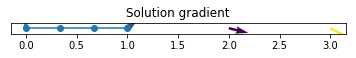

 1.1920928955078125e-06 seconds 


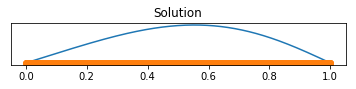

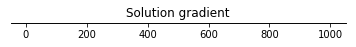

 1.6689300537109375e-06 seconds 


In [22]:
# Unsteady  Burguers  CG  linear      SUPG                                   For different degrees of freedom

"""
STEADY BURGUERS EQUATION CG
This demo program solves Poisson's equation
    (u^2/2)_x - u_xx = f(x)
on the unit interval with source f given by
    f(x) = 9*pi^2*sin(3*pi*x[0])
and boundary conditions given by
    u(0) = u(1) = 0
"""

import time
from dolfin import *
import matplotlib.pyplot as plt

for N in [3, 1000]:

    # Create mesh
    mesh = UnitIntervalMesh(N)

    # save mesh
    File("burguers_steady_CG_nonlinear/mesh.xml") << mesh

    """
    STEADY BURGUERS EQUATION
    This demo program solves Poisson's equation
        (u^2/2)_x - u_xx = f(x)
    on the unit interval with source f given by
        f(x) = 9*pi^2*sin(3*pi*x[0])
    and boundary conditions given by
        u(0) = u(1) = 0
    """
    import time
    from dolfin import *
    import matplotlib.pyplot as plt

    # Form compiler options
    parameters["form_compiler"]["optimize"]     = True
    parameters["form_compiler"]["cpp_optimize"] = True
    #parameters["form_compiler"]["representation"] = "quadrature"
    #parameters["form_compiler"]["quadrature_degree"] = 8
    # Read mesh

    mesh = Mesh("burguers_steady_CG_nonlinear/mesh.xml")


    p=2
    # FE function space
    V    = FunctionSpace(mesh, "CG", p)

    # Sub domain for Dirichlet boundary condition
    def DirichletBoundary(x):
         return x[0] < DOLFIN_EPS or x[0] > 1.0 - DOLFIN_EPS

    # Define variational problem
    f = Expression("10.0*x[0]*(1.0-x[0])*sin(x[0])", degree=p)
    #g = grad(f)

    v  = TestFunction(V)
    u  = Function(V, name="Variables at current step")
    du = TrialFunction(V)

    #F = (-0.5*u**2*v.dx(0) + inner(grad(u), grad(v)))*dx - f*v*dx
    F = (u*v*Dx(u,0) + inner(grad(u), grad(v)))*dx - f*v*dx
    dF= derivative(F, u, du)

    # Define boundary condition
    u0 = Constant(0.0)
    bc = DirichletBC(V, u0, DirichletBoundary)

    # Solve PDE

    problem = NonlinearVariationalProblem(F,u,bcs=bc,J=dF)
    solver = NonlinearVariationalSolver(problem)
    prm = solver.parameters

    # Define solver parameters
    info(prm, True)
    prm['nonlinear_solver'] = 'newton'
    prm['newton_solver']['linear_solver'] = 'umfpack'
    prm['newton_solver']['report'] = True
    prm['newton_solver']['absolute_tolerance'] = 1E-8
    prm['newton_solver']['relative_tolerance'] = 1E-7
    prm['newton_solver']['maximum_iterations'] = 25
    prm['newton_solver']['relaxation_parameter'] = 1.0
    prm['newton_solver']['convergence_criterion'] = 'incremental'
    #prm['newton_solver']['error_on_nonconvergence'] = True
    #prm['newton_solver']['lu_solver']['report'] = False
    #prm['newton_solver']['lu_solver']['same_nonzero_pattern']=True    
    solver.solve()

    # Plot solution and solution gradient
    plt.figure()
    plot(u, title="Solution")
    plot(u.function_space().mesh())

    plt.figure()
    plot(grad(u), title="Solution gradient")
    plot(u.function_space().mesh())

    plt.show()

    # Save solution in VTK format
    ufile_pvd = File("burguers_steady_CG_nonlinear/u.pvd")
    ufile_pvd << u

    # Show time of the program's execution
    start_time = time.time()

    if __name__ == '__main__':
        print(" %s seconds " % (time.time() - start_time))

In [1]:
# Steady    Poisson   CG  linear      general solver function

"""
FEniCS tutorial demo program: Poisson equation with Dirichlet conditions.
Test problem is chosen to give an exact solution at all nodes of the mesh.

  -Laplace(u) = f    in the unit square
            u = u_D  on the boundary

  u = 1 + x^2 + 2y^2 = u_D
  f = -6

This is an extended version of the demo program poisson.py which
encapsulates the solver as a Python function.
"""

from __future__ import print_function
from fenics import *
import numpy as np

def solver(f, u_D, Nx, Ny, degree=1):
    """
    Solve -Laplace(u) = f on [0,1] x [0,1] with 2*Nx*Ny Lagrange
    elements of specified degree and u = u_D (Expresssion) on
    the boundary.
    """

    # Create mesh and define function space
    mesh = UnitSquareMesh(Nx, Ny)
    V = FunctionSpace(mesh, 'P', degree)

    # Define boundary condition
    def boundary(x, on_boundary):
        return on_boundary

    bc = DirichletBC(V, u_D, boundary)

    # Define variational problem
    u = TrialFunction(V)
    v = TestFunction(V)
    a = dot(grad(u), grad(v))*dx
    L = f*v*dx

    # Compute solution
    u = Function(V)
    solve(a == L, u, bc)

    return u

def run_solver():
    "Run solver to compute and post-process solution"

    # Set up problem parameters and call solver
    u_D = Expression('1 + x[0]*x[0] + 2*x[1]*x[1]', degree=2)
    f = Constant(-6.0)
    u = solver(f, u_D, 8, 8, 1)

    # Plot solution and mesh
    plot(u)
    plot(u.function_space().mesh())

    # Save solution to file in VTK format
    vtkfile = File('poisson_solver/solution.pvd')
    vtkfile << u

def test_solver():
    "Test solver by reproducing u = 1 + x^2 + 2y^2"

    # Set up parameters for testing
    tol = 1E-10
    u_D = Expression('1 + x[0]*x[0] + 2*x[1]*x[1]', degree=2)
    f = Constant(-6.0)

    # Iterate over mesh sizes and degrees
    for Nx, Ny in [(3, 3), (3, 5), (5, 3), (20, 20)]:
        for degree in 1, 2, 3:
            print('Solving on a 2 x (%d x %d) mesh with P%d elements.'
                  % (Nx, Ny, degree))

            # Compute solution
            u = solver(f, u_D, Nx, Ny, degree)

            # Extract the mesh
            mesh = u.function_space().mesh()

            # Compute maximum error at vertices
            vertex_values_u_D = u_D.compute_vertex_values(mesh)
            vertex_values_u  = u.compute_vertex_values(mesh)
            error_max = np.max(np.abs(vertex_values_u_D - \
                                      vertex_values_u))

            # Check maximum error
            msg = 'error_max = %g' % error_max
            assert error_max < tol, msg
            print(msg)
            #print(tol)

if __name__ == '__main__':
    run_solver()
    test_solver()
    


Solving on a 2 x (3 x 3) mesh with P1 elements.
error_max = 2.22045e-16
Solving on a 2 x (3 x 3) mesh with P2 elements.
error_max = 4.44089e-15
Solving on a 2 x (3 x 3) mesh with P3 elements.
error_max = 4.26326e-14
Solving on a 2 x (3 x 5) mesh with P1 elements.
error_max = 1.33227e-15
Solving on a 2 x (3 x 5) mesh with P2 elements.
error_max = 1.02141e-14
Solving on a 2 x (3 x 5) mesh with P3 elements.
error_max = 8.52651e-14
Solving on a 2 x (5 x 3) mesh with P1 elements.
error_max = 1.33227e-15
Solving on a 2 x (5 x 3) mesh with P2 elements.
error_max = 1.28786e-14
Solving on a 2 x (5 x 3) mesh with P3 elements.
error_max = 8.79297e-14
Solving on a 2 x (20 x 20) mesh with P1 elements.
error_max = 1.19904e-14
Solving on a 2 x (20 x 20) mesh with P2 elements.
error_max = 2.78444e-13
Solving on a 2 x (20 x 20) mesh with P3 elements.
error_max = 2.06679e-12


Solving on a 2 x (3 x 3) mesh with P1 elements.
error_max = 4.44089e-16
Solving on a 2 x (3 x 3) mesh with P2 elements.
error_max = 4.88498e-15
Solving on a 2 x (3 x 3) mesh with P3 elements.
error_max = 4.08562e-14
Solving on a 2 x (3 x 5) mesh with P1 elements.
error_max = 1.33227e-15
Solving on a 2 x (3 x 5) mesh with P2 elements.
error_max = 1.06581e-14
Solving on a 2 x (3 x 5) mesh with P3 elements.
error_max = 8.52651e-14
Solving on a 2 x (5 x 3) mesh with P1 elements.
error_max = 1.77636e-15
Solving on a 2 x (5 x 3) mesh with P2 elements.
error_max = 1.28786e-14
Solving on a 2 x (5 x 3) mesh with P3 elements.
error_max = 8.79297e-14
Solving on a 2 x (20 x 20) mesh with P1 elements.
error_max = 1.19904e-14
Solving on a 2 x (20 x 20) mesh with P2 elements.
error_max = 2.78444e-13
Solving on a 2 x (20 x 20) mesh with P3 elements.
error_max = 2.06613e-12


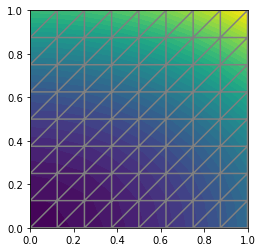

In [2]:
# Steady    Poisson   CG  nonlinear   general solver function		     With vertex values
"""
FEniCS tutorial demo program: Poisson equation with Dirichlet conditions.
Test problem is chosen to give an exact solution at all nodes of the mesh.

  -Laplace(u) = f    in the unit square
            u = u_D  on the boundary

  u = 1 + x^2 + 2y^2 = u_D
  f = -6

This is an extended version of the demo program poisson.py which
encapsulates the solver as a Python function.
"""

from __future__ import print_function
from fenics import *
import numpy as np

def solver(f, u_D, Nx, Ny, degree=1):
    """
    Solve -Laplace(u) = f on [0,1] x [0,1] with 2*Nx*Ny Lagrange
    elements of specified degree and u = u_D (Expresssion) on
    the boundary.
    """

    # Create mesh and define function space
    mesh = UnitSquareMesh(Nx, Ny)
    V = FunctionSpace(mesh, 'P', degree)

    # Define boundary condition
    def boundary(x, on_boundary):
        return on_boundary

    bc = DirichletBC(V, u_D, boundary)

    # Define variational problem
    v  = TestFunction(V)
    u  = Function(V)
    du = TrialFunction(V)
    a  = dot(grad(u), grad(v))*dx
    L  = f*v*dx
    F  = dot(grad(u), grad(v))*dx - f*v*dx
    
    # Compute solution
    dF= derivative(F, u, du)
    
    # Solve PDE

    problem = NonlinearVariationalProblem(F, u, bcs = bc, J = dF)
    solver = NonlinearVariationalSolver(problem)
    solver.solve()
    
    return u

def run_solver():
    "Run solver to compute and post-process solution"

    # Set up problem parameters and call solver
    u_D = Expression('1 + x[0]*x[0] + 2*x[1]*x[1]', degree=2)
    f = Constant(-6.0)
    u = solver(f, u_D, 8, 8, 1) #previous function

    # Plot solution and mesh
    plot(u)
    plot(u.function_space().mesh())

    # Save solution to file in VTK format
    vtkfile = File('poisson_solver/solution.pvd')
    vtkfile << u

def test_solver():
    "Test solver by reproducing u = 1 + x^2 + 2y^2"

    # Set up parameters for testing
    tol = 1E-10
    u_D = Expression('1 + x[0]*x[0] + 2*x[1]*x[1]', degree=2)
    f = Constant(-6.0)

    # Iterate over mesh sizes and degrees
    for Nx, Ny in [(3, 3), (3, 5), (5, 3), (20, 20)]:
        for degree in 1, 2, 3:
            print('Solving on a 2 x (%d x %d) mesh with P%d elements.'
                  % (Nx, Ny, degree))

            # Compute solution
            u = solver(f, u_D, Nx, Ny, degree)

            # Extract the mesh
            mesh = u.function_space().mesh()

            # Compute maximum error at vertices
            vertex_values_u_D = u_D.compute_vertex_values(mesh)
            vertex_values_u  = u.compute_vertex_values(mesh)
            error_max = np.max(np.abs(vertex_values_u_D - \
                                      vertex_values_u))

            # Check maximum error
            msg = 'error_max = %g' % error_max
            assert error_max < tol, msg
            print(msg)
            #print(tol)

if __name__ == '__main__':
    run_solver()
    test_solver()
    



Time of the program's execution: 4.076957702636719e-05 seconds 


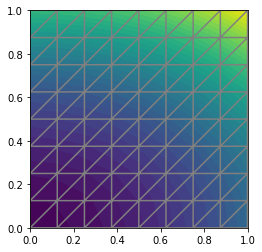

In [5]:
# Steady    Poisson   CG  nonlinear   general solver function		     With all the parameters

"""
FEniCS tutorial demo program: Poisson equation with Dirichlet conditions.
Test problem is chosen to give an exact solution at all nodes of the mesh.

  -Laplace(u) = f    in the unit square
            u = u_D  on the boundary

  u = 1 + x^2 + 2y^2 = u_D
  f = -6

This is an extended version of the demo program poisson.py which
encapsulates the solver as a Python function.
"""

from __future__ import print_function
from fenics import *
import numpy as np
import time

# This demo requires PETSc
if not has_petsc():
    print("DOLFIN must be compiled with PETSc to run this demo.")
    exit(0)
    
def solver(f, u_D, Nx, Ny, 
           degree                 = 2, 
           abs_tol_newton         = 1E-8,
           linear_solver_newton   = 'gmres',
           max_iter_newton        = 25,
           preconditioner_newton  = 'ilu',
           rel_tol_newton         = 1E-8,
           relaxat_newton         = 1.0,
           abs_tol_krylov         = 1E-5,
           rel_tol_krylov         = 1E-3,
           max_iter_krylov        = 1000):
    """
    Solve -Laplace(u) = f on [0,1] x [0,1] with 2*Nx*Ny Lagrange
    elements of specified degree and u = u_D (Expresssion) on
    the boundary.
    """

    # Create mesh and define function space
    mesh = UnitSquareMesh(Nx, Ny)
    V = FunctionSpace(mesh, 'P', degree)

    # Define boundary condition
    def boundary(x, on_boundary):
        return on_boundary

    bc = DirichletBC(V, u_D, boundary)

    # Define variational problem
    v  = TestFunction(V)
    u  = Function(V)
    du = TrialFunction(V)
    a  = dot(grad(u), grad(v))*dx
    L  = f*v*dx
    F  = dot(grad(u), grad(v))*dx - f*v*dx
    
    dF= derivative(F, u, du)
    
    # Set linear solver parameters
    
    problem = NonlinearVariationalProblem (F, u, bcs = bc, J = dF)
    solver  = NonlinearVariationalSolver (problem)
    prm     = solver.parameters
    
    info(prm, True)
    
    prm ['nonlinear_solver'] = 'newton'
    prm ['print_matrix']     = False #True
    prm ['print_rhs']        = False #True
    prm ['symmetric']        = False #True
    
    prm ['newton_solver']['absolute_tolerance']      = abs_tol_newton
    prm ['newton_solver']['convergence_criterion']   = 'incremental' #'residual'
    prm ['newton_solver']['error_on_nonconvergence'] = True
    prm ['newton_solver']['linear_solver']           = linear_solver_newton       #'ml_amg'
    prm ['newton_solver']['maximum_iterations']      = max_iter_newton
    prm ['newton_solver']['preconditioner']          = preconditioner_newton
    prm ['newton_solver']['relative_tolerance']      = rel_tol_newton
    prm ['newton_solver']['relaxation_parameter']    = relaxat_newton
    prm ['newton_solver']['report']                  = True

    prm ['newton_solver']['krylov_solver']['absolute_tolerance']       = abs_tol_krylov #1E-9
    #prm ['newton_solver']['krylov_solver']['divergence_limit']         = 
    prm ['newton_solver']['krylov_solver']['error_on_nonconvergence']  = True
    prm ['newton_solver']['krylov_solver']['maximum_iterations']       = max_iter_krylov
    prm ['newton_solver']['krylov_solver']["monitor_convergence"]      = True
    prm ['newton_solver']['krylov_solver']["nonzero_initial_guess"]    = True #False
    prm ['newton_solver']['krylov_solver']['relative_tolerance']       = rel_tol_krylov
    prm ['newton_solver']['krylov_solver']['report']                   = True
    
    prm ['newton_solver']['lu_solver']['report']    = True
    prm ['newton_solver']['lu_solver']['symmetric'] = True
    prm ['newton_solver']['lu_solver']['verbose']   = True

    PROGRESS = 16
    set_log_level(PROGRESS)
    
    solver.solve()
    
    return u

def run_solver():
    "Run solver to compute and post-process solution"

    # Set up problem parameters and call solver
    u_D = Expression('1 + x[0]*x[0] + 2*x[1]*x[1]', degree=2)
    f = Constant(-6.0)
    u = solver(f, u_D, 8, 8, 1) #previous function

    # Plot solution and mesh
    plot(u)
    plot(u.function_space().mesh())

    # Save solution to file in VTK format
    vtkfile = File('poisson_solver/solution.pvd')
    vtkfile << u

if __name__ == '__main__':
    run_solver()
    #test_solver()
    
# Show time of the program's execution
start_time  = time.time ()
if __name__ == '__main__':
    print("Time of the program's execution: %s seconds " % (time.time () - start_time))

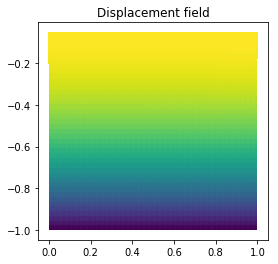

In [6]:
# Steady    Elasticity CG linear/nonlinear PETSC/TAO solvers		     bounded constraints / assembled     

"""This demo uses PETSc's TAO solver for nonlinear (bound-constrained)
optimisation problems to solve a contact mechanics problem in FEniCS.
We consider here a heavy hyperelastic circle under body force
in a box of the same size."""

# Copyright (C) 2012 Corrado Maurini
#
# This file is part of DOLFIN.
#
# DOLFIN is free software: you can redistribute it and/or modify
# it under the terms of the GNU Lesser General Public License as published by
# the Free Software Foundation, either version 3 of the License, or
# (at your option) any later version.
#
# DOLFIN is distributed in the hope that it will be useful,
# but WITHOUT ANY WARRANTY; without even the implied warranty of
# MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE. See the
# GNU Lesser General Public License for more details.
#
# You should have received a copy of the GNU Lesser General Public License
# along with DOLFIN. If not, see <http://www.gnu.org/licenses/>.
#
# Modified by Tianyi Li 2014
#
# First added:  2012-09-03
# Last changed: 2014-07-19

from __future__ import print_function
from dolfin import *

if not has_petsc():
    print("DOLFIN must be compiled with PETSc to run this demo.")
    exit(0)

# Read mesh
mesh    = UnitSquareMesh(40,40)

# Create function space
V = VectorFunctionSpace(mesh, "Lagrange", 1)

# Define functions
du = TrialFunction(V)            # Incremental displacement
v  = TestFunction(V)             # Test function
u  = Function(V)                 # Displacement from previous iteration
B  = Constant((0.0, -1.5))       # Body force per unit volume

# Kinematics
I = Identity(len(u))  # Identity tensor
F = I + grad(u)             # Deformation gradient
C = F.T*F                   # Right Cauchy-Green tensor

# Invariants of deformation tensors
Ic = tr(C)
J  = det(F)

# Elasticity parameters
E, nu = 10.0, 0.3
mu, lmbda = Constant(E/(2*(1+nu))), Constant(E*nu/((1+nu)*(1-2*nu)))

# Stored strain energy density (compressible neo-Hookean model)
psi = (mu/2)*(Ic-2) - mu*ln(J) + (lmbda/2)*(ln(J))**2

# Total potential energy
Pi = psi*dx - dot(B, u)*dx

# Compute first variation of Pi (directional derivative about u in the
# direction of v)
F = derivative(Pi, u, v)

# Compute Jacobian of F
J = derivative(F, u, du)

# Define the minimisation problem by using OptimisationProblem class
class ContactProblem(OptimisationProblem):

    def __init__(self):
        OptimisationProblem.__init__(self)

    # Objective function
    def f(self, x):
        u.vector()[:] = x
        return assemble(Pi)

    # Gradient of the objective function
    def F(self, b, x):
        u.vector()[:] = x
        assemble(F, tensor=b)

    # Hessian of the objective function
    def J(self, A, x):
        u.vector()[:] = x
        assemble(J, tensor=A)

# The displacement u must be such that the current configuration
# doesn't escape the box [xmin, xmax] x [ymin, ymax]
constraint_u = Expression(("xmax-x[0]", "ymax-x[1]"), xmax=1.0, ymax=1.0, degree=1)
constraint_l = Expression(("xmin-x[0]", "ymin-x[1]"), xmin=-1.0, ymin=-1.0, degree=1)
u_min = interpolate(constraint_l, V)
u_max = interpolate(constraint_u, V)

# Symmetry condition (to block rigid body rotations)
def symmetry_line(x, on_boundary):
    return near(x[0], 0)
bc = DirichletBC(V.sub(0), Constant(0.0), symmetry_line)
bc.apply(u_min.vector())  # BC will be incorporated into the lower
bc.apply(u_max.vector())  # and upper bounds

# Create the PETScTAOSolver
solver = PETScTAOSolver()
prm     = solver.parameters
    
info(prm, True)
    
# Set some parameters
prm["method"] = "tron"  # when using gpcg make sure that you have a constant Hessian
# solver.parameters["linear_solver"] = "nash"
prm["line_search"] = "gpcg"
# solver.parameters["preconditioner"] = "ml_amg"
prm["monitor_convergence"] = True
prm["report"] = True

# Uncomment this line to see the available parameters
# info(parameters, True)

# Parse (PETSc) parameters
#parameters.parse()

# Solve the problem
solver.solve(ContactProblem(), u.vector(), u_min.vector(), u_max.vector())

# Save solution in XDMF format if available
out = XDMFFile(mesh.mpi_comm(), "u.xdmf")
if has_hdf5():
    out.write(u)
elif MPI.size(mesh.mpi_comm()) == 1:
    encoding = XDMFFile.Encoding_ASCII
    out.write(u, encoding)
else:
    # Save solution in vtk format
    out = File("u.pvd")
    out << u

# Plot the current configuration
plot(u, mode="displacement", wireframe=True, title="Displacement field")
#interactive()


Calling FFC just-in-time (JIT) compiler, this may take some time.
  Ignoring precision in integral metadata compiled using quadrature representation. Not implemented.
Calling FFC just-in-time (JIT) compiler, this may take some time.


/usr/lib/python3/dist-packages/ffc/quadrature/quadraturerepresentation.py:58: QuadratureRepresentationDeprecationWarning: 
*** ===================================================== ***
*** FFC: quadrature representation is deprecated! It will ***
*** likely be removed in 2018.2.0 release. Use uflacs     ***
*** representation instead.                               ***
*** ===================================================== ***
  issue_deprecation_warning()


Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
  Ignoring precision in integral metadata compiled using quadrature representation. Not implemented.
  Ignoring precision in integral metadata compiled using quadrature representation. Not implemented.
Calling FFC just-in-time (JIT) compiler, this may take some time.


/usr/lib/python3/dist-packages/ffc/jitcompiler.py:234: QuadratureRepresentationDeprecationWarning: 
*** ===================================================== ***
*** FFC: quadrature representation is deprecated! It will ***
*** likely be removed in 2018.2.0 release. Use uflacs     ***
*** representation instead.                               ***
*** ===================================================== ***
  issue_deprecation_warning()
/usr/lib/python3/dist-packages/ffc/quadrature/quadraturerepresentation.py:58: QuadratureRepresentationDeprecationWarning: 
*** ===================================================== ***
*** FFC: quadrature representation is deprecated! It will ***
*** likely be removed in 2018.2.0 release. Use uflacs     ***
*** representation instead.                               ***
*** ===================================================== ***
  issue_deprecation_warning()
/usr/lib/python3/dist-packages/ffc/quadrature/quadraturerepresentation.py:58: QuadratureRepresent

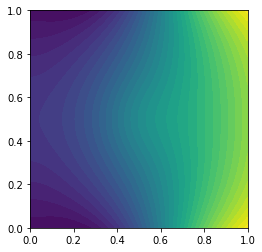

In [22]:
# Steady    Poisson   CG  linear      KrylovSolver			     assembled with parameters      null vector

from dolfin import *

# Test for PETSc
if not has_linear_algebra_backend("PETSc"):
    info("DOLFIN has not been configured with TPETSc. Exiting.")
    exit()

parameters["linear_algebra_backend"] = "PETSc"

# Create mesh and define function space
mesh = UnitSquareMesh(64, 64)
V = FunctionSpace(mesh, "CG", 1)

# Define variational problem
u = TrialFunction(V)
v = TestFunction(V)
f = Expression("10*exp(-(pow(x[0] - 0.5, 2) + pow(x[1] - 0.5, 2)) / 0.02)", degree=2)
g = Expression("-sin(5*x[0])", degree=2)
a = inner(grad(u), grad(v))*dx
L = f*v*dx + g*v*ds

# Assemble system
A = assemble(a)
b = assemble(L)

# Solution Function
u = Function(V)

# Create Krylov solver


solver = KrylovSolver(A, "gmres", "ilu")
prm     = solver.parameters
    
info(prm, True)

#prm ['nonlinear_solver'] = 'newton' 

prm ['absolute_tolerance']       = 1E-5 #1E-9
#prm ['newton_solver']['krylov_solver']['divergence_limit']         = 
prm ['error_on_nonconvergence']  = True
prm ['maximum_iterations']       = 1000 # 500000
prm ["monitor_convergence"]      = True
prm ["nonzero_initial_guess"]    = True #False
prm ['relative_tolerance']       = 1E-3
prm ['report']                   = True
    
# Create vector that spans the null space
null_vec = Vector(u.vector())
V.dofmap().set(null_vec, 1.0)
null_vec *= 1.0/null_vec.norm("l2")

# Create null space basis object and attach to Krylov solver
null_space = VectorSpaceBasis([null_vec])
#solver.set_nullspace(null_space)

 # Orthogonalize b with respect to the null space (this gurantees that
 # a solution exists)
null_space.orthogonalize(b);

# Solve
solver.solve(u.vector(), b)

# Plot solution
plot(u)


Solution of the Poisson problem -Laplace(u) = f,
with u = u0 on x=0,1 and -du/dn = g at y=0,1.



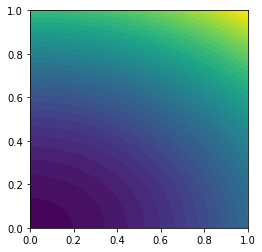

In [6]:
# Steady    Poisson   CG  linear      KrylovSolver			     assembled with parameters       SIMPLE

"""
FEniCS tutorial demo program:
Poisson equation with Dirichlet and Neumann conditions.
As dn3_p2D.py, but use of KrylovSolver instead of solve
(and control of stopping criterion).

-Laplace(u) = f on the unit square.
u = 1 + 2y^2 on x=0.
u = 2 + 2y^2 on x=1.
-du/dn = g on y=0 and y=1.
u = 1 + x^2 + 2y^2, f = -6, g = -4y.
"""

from dolfin import *
import numpy

# Create mesh and define function space
mesh = UnitSquareMesh(40, 40)
V = FunctionSpace(mesh, 'Lagrange', 1)

# Define Dirichlet conditions for x=0 boundary

u_L = Expression('1 + 2*x[1]*x[1]', degree=1)

class LeftBoundary(SubDomain):
    def inside(self, x, on_boundary):
        tol = 1E-14   # tolerance for coordinate comparisons
        return on_boundary and abs(x[0]) < tol

Gamma_0 = DirichletBC(V, u_L, LeftBoundary())

# Define Dirichlet conditions for x=1 boundary

u_R = Expression('2 + 2*x[1]*x[1]', degree=1)

class RightBoundary(SubDomain):
    def inside(self, x, on_boundary):
        tol = 1E-14   # tolerance for coordinate comparisons
        return on_boundary and abs(x[0] - 1) < tol

Gamma_1 = DirichletBC(V, u_R, RightBoundary())

bcs = [Gamma_0, Gamma_1]

# Define variational problem
u = TrialFunction(V)
v = TestFunction(V)
f = Constant(-6.0)
g = Expression('-4*x[1]', degree=1)
a = inner(grad(u), grad(v))*dx
L = f*v*dx - g*v*ds

# Assemble and solve linear system
A = assemble(a)
b = assemble(L)

if mesh.num_cells() < 16:
    print('A = assemble(a); b = assemble(L)')
    print('A before incorporation of essential BC:\n', A.array())
    print ('b before incorporation of essential BC:\n', b.array())

for bc in bcs:
    bc.apply(A, b)

if mesh.num_cells() < 16:
    print ('A after incorporation of essential BC:\n', A.array())
    print ('b after incorporation of essential BC:\n', b.array())

# Alternative creation of the linear system
# (symmetric modification of boundary conditions)
A, b = assemble_system(a, L, bcs)

if mesh.num_cells() < 16:
    print ('\nA, b = assemble_system(a, L, bcs)')
    print ('A after incorporation of essential BC:\n', A.array())
    print ('b after incorporation of essential BC:\n', b.array())

# Compute solution
solver = KrylovSolver('cg', 'ilu')
#solver = KrylovSolver('cg', 'none')

info(solver.parameters, True)
solver.parameters['absolute_tolerance'] = 1E-8
solver.parameters['relative_tolerance'] = 1E-8
solver.parameters["monitor_convergence"] = False
solver.parameters["report"] = False
solver.parameters['maximum_iterations'] = 10000
solver.parameters['nonzero_initial_guess'] = True

u = Function(V)
U = u.vector()
set_log_level(1)
solver.solve(A, U, b)

#import numpy


plot(u)

print("""
Solution of the Poisson problem -Laplace(u) = f,
with u = u0 on x=0,1 and -du/dn = g at y=0,1.
%s
""" % mesh)

In [8]:
# Steady    Heat   CG  nonlinear      			     assembled with parameters       SIMPLE Manually
import random
from dolfin import *

# Test for PETSc
if not has_linear_algebra_backend("PETSc"):
    info("DOLFIN has not been configured with TPETSc. Exiting.")
    exit()

parameters["linear_algebra_backend"] = "PETSc"

# Class for interfacing with the Newton solver
class Poissonassembled(NonlinearProblem):
    def __init__(self, a, L):
        NonlinearProblem.__init__(self)
        self.L = L
        self.a = a
    def F(self, b, x):
        assemble(self.L, tensor=b)
    def J(self, A, x):
        assemble(self.a, tensor=A)

parameters["form_compiler"]["optimize"]     = True
parameters["form_compiler"]["cpp_optimize"] = True

# Create mesh and define function space
mesh = UnitSquareMesh(64, 64)
p=2
# FE function space
V    = FunctionSpace(mesh, "CG", p)

# Sub domain for Dirichlet boundary condition
def DirichletBoundary(x):
     return x[0] < DOLFIN_EPS or x[0] > 1.0 - DOLFIN_EPS

# Define variational problem
f = Expression("10.0*x[0]*(1.0-x[0])*sin(x[0])", degree=p)
#g = grad(f)

v  = TestFunction(V)
u  = Function(V, name="Variables at current step")
du = TrialFunction(V)

#F = (-0.5*u**2*v.dx(0) + inner(grad(u), grad(v)))*dx - f*v*dx
L = inner(grad(u), grad(v))*dx - f*v*dx

# Compute directional derivative about u in the direction of du (Jacobian)
a = derivative(L, u, du)


# Create nonlinear problem and Newton solver
problem = Poissonassembled(a, L)
solver = NewtonSolver()
prm     = solver.parameters

info(prm, True)

prm ['absolute_tolerance']      = 1E-3
#prm ['convergence_criterion']   = 'incremental' #'residual'
prm ['error_on_nonconvergence'] = True
prm ['linear_solver']           = 'gmres'       #'ml_amg'
prm ['maximum_iterations']      = 50
prm ['preconditioner']          = 'ilu'
prm ['relative_tolerance']      = 1E-3
prm ['relaxation_parameter']    = 1.0
prm ['report']                  = True
    
prm ['krylov_solver']['absolute_tolerance']       = 1E-5 #1E-9
#prm ['krylov_solver']['divergence_limit']         = 
prm ['krylov_solver']['error_on_nonconvergence']  = True
prm ['krylov_solver']['maximum_iterations']       = 10000 # 
prm ['krylov_solver']["monitor_convergence"]      = True
prm ['krylov_solver']["nonzero_initial_guess"]    = True #False
prm ['krylov_solver']['relative_tolerance']       = 1E-3
prm ['krylov_solver']['report']                   = True
    
prm ['lu_solver']['report']    = True
prm ['lu_solver']['symmetric'] = True
prm ['lu_solver']['verbose']   = True
    
solver.solve(problem, u.vector())

# Plot solution
plot(u)


RuntimeError: 

*** -------------------------------------------------------------------------
*** DOLFIN encountered an error. If you are not able to resolve this issue
*** using the information listed below, you can ask for help at
***
***     fenics-support@googlegroups.com
***
*** Remember to include the error message listed below and, if possible,
*** include a *minimal* running example to reproduce the error.
***
*** -------------------------------------------------------------------------
*** Error:   Unable to solve linear system using PETSc Krylov solver.
*** Reason:  Solution failed to converge in 10000 iterations (PETSc reason DIVERGED_ITS, residual norm ||r|| = 4.951969e-03).
*** Where:   This error was encountered inside PETScKrylovSolver.cpp.
*** Process: 0
*** 
*** DOLFIN version: 2019.1.0
*** Git changeset:  unknown
*** -------------------------------------------------------------------------


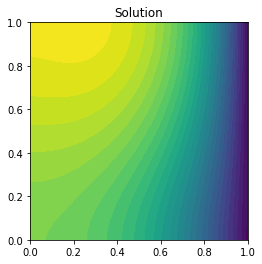

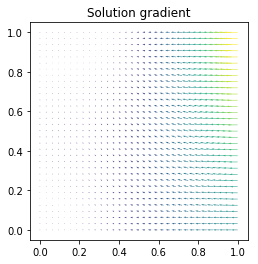

In [2]:
#Poisson Newtonsolver Manually 2D 

import matplotlib.pyplot as plt
from dolfin import *


class Problem(NonlinearProblem):
    def __init__(self, J, F, bcs):
        self.bilinear_form = J
        self.linear_form = F
        self.bcs = bcs
        NonlinearProblem.__init__(self)

    def F(self, b, x):
        assemble(self.linear_form, tensor=b)
        for bc in self.bcs:
            bc.apply(b, x)

    def J(self, A, x):
        assemble(self.bilinear_form, tensor=A)
        for bc in self.bcs:
            bc.apply(A)


class CustomSolver(NewtonSolver):
    def __init__(self):
        NewtonSolver.__init__(self, mesh.mpi_comm(),
                              PETScKrylovSolver(), PETScFactory.instance())

    def solver_setup(self, A, P, problem, iteration):
        self.linear_solver().set_operator(A)

        PETScOptions.set("ksp_type", "gmres")
        PETScOptions.set("ksp_monitor")        
        PETScOptions.set("pc_type", "ilu")

        self.linear_solver().set_from_options()


mesh = UnitSquareMesh(32, 32)

V = FunctionSpace(mesh, "CG", 1)
g = Constant(1.0)
bcs = [DirichletBC(V, g, "near(x[0], 1.0) and on_boundary")]
u = Function(V)
v = TestFunction(V)
f = Expression("x[0]*sin(x[1])", degree=2)
F = inner((1 + u**2)*grad(u), grad(v))*dx - f*v*dx
J = derivative(F, u)

problem = Problem(J, F, bcs)
custom_solver = CustomSolver()
custom_solver.solve(problem, u.vector())

plt.figure()
plot(u, title="Solution")

plt.figure()
plot(grad(u), title="Solution gradient")

plt.show()

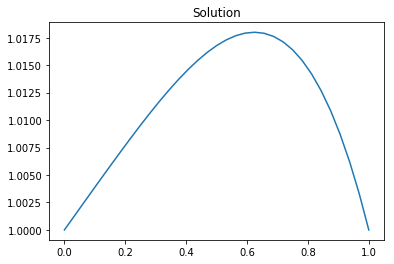

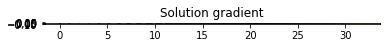

In [6]:
#Poisson Newtonsolver Manually 1D 

import matplotlib.pyplot as plt
from dolfin import *


class Problem(NonlinearProblem):
    def __init__(self, J, F, bcs):
        self.bilinear_form = J
        self.linear_form = F
        self.bcs = bcs
        NonlinearProblem.__init__(self)

    def F(self, b, x):
        assemble(self.linear_form, tensor=b)
        for bc in self.bcs:
            bc.apply(b, x)

    def J(self, A, x):
        assemble(self.bilinear_form, tensor=A)
        for bc in self.bcs:
            bc.apply(A)


class CustomSolver(NewtonSolver):
    def __init__(self):
        NewtonSolver.__init__(self, mesh.mpi_comm(),
                              PETScKrylovSolver(), PETScFactory.instance())

    def solver_setup(self, A, P, problem, iteration):
        self.linear_solver().set_operator(A)

        #https://www.mcs.anl.gov/petsc/documentation/index.html
            #https://www.mcs.anl.gov/petsc/petsc-current/docs/manualpages/TS/TSType.html
        PETScOptions.set("ts_type", "tsrk")
        
        
        
        PETScOptions.set("ts_rk_type", "2a")#<1fe,2a,3,3bs,4,5f,5dp,5bs> 
        PETScOptions.set("ts_ssp_type", "rks2") #Type of SSP method (one of) rks2 rks3 rks104 
        PETScOptions.set("ts_ssp_nstages", 5) #Number of stages
        
        
            #https://www.mcs.anl.gov/petsc/petsc-current/docs/manualpages/SNES/SNESSetType.html#SNESSetType
            #https://www.mcs.anl.gov/petsc/petsc-current/docs/manualpages/SNES/SNESSetFromOptions.html#SNESSetFromOptions        PETScOptions.set("snes_type", "newtonls")  #Newton's method with line search (systems of nonlinear equations)
        PETScOptions.set("snes_type", "newtonls")  #Newton's method with line search (systems of nonlinear equations)
        PETScOptions.set("snes_stol", 1e-8)  #convergence tolerance in terms of the norm of the change in the solution between steps
        PETScOptions.set("snes_atol", 1e-8)  #absolute tolerance of residual norm
        PETScOptions.set("snes_rtol", 1e-8)  #relative decrease in tolerance norm from initial
        PETScOptions.set("snes_max_it", 100)  #maximum number of iterations
        PETScOptions.set("snes_converged_reason")  #print the reason for convergence/divergence after each solve
        PETScOptions.set("npc_snes_type", "ngmres")  #the SNES type to use as a nonlinear preconditioner
            #https://www.mcs.anl.gov/petsc/petsc-current/docs/manualpages/KSP/
                #https://www.mcs.anl.gov/petsc/petsc-current/docs/manualpages/KSP/KSPType.html
        PETScOptions.set("ksp_monitor")
        PETScOptions.set("ksp_initial_guess_nonzero", True)
        #PETScOptions.set("ksp_compute_eigenvalues")
        PETScOptions.set("ksp_view_final_residual")
        PETScOptions.set("ksp_view")
        
                #https://www.mcs.anl.gov/petsc/petsc-current/docs/manualpages/KSP/KSPSetFromOptions.html
        PETScOptions.set("ksp_max_it", 150) # maximum number of linear iterations
        PETScOptions.set("ksp_rtol rtol", 1e-8) # relative tolerance used in default determination of convergence, i.e. if residual norm decreases by this factor than convergence is declared
        PETScOptions.set("ksp_atol abstol", 1e-8) # absolute tolerance used in default convergence test, i.e. if residual norm is less than this then convergence is declared

                #https://www.mcs.anl.gov/petsc/petsc-current/docs/manualpages/KSP/KSPType.html
        PETScOptions.set("ksp_type", "gmres") 
        PETScOptions.set("ksp_gmres_haptol", 3e-3) #sets the tolerance for "happy ending" (exact convergence)
        PETScOptions.set("ksp_gmres_modifiedgramschmidt") #use modified Gram-Schmidt in the orthogonalization (more stable, but slower)
        PETScOptions.set("ksp_gmres_preallocate") #preallocate all the Krylov search directions initially (otherwise groups of vectors are allocated as needed)
        PETScOptions.set("ksp_gmres_krylov_monitor") #plot the Krylov space generated
        PETScOptions.set("ksp_gmres_restart", 30) # the number of Krylov directions to orthogonalize against
        
            #https://www.mcs.anl.gov/petsc/petsc-current/docs/manualpages/PC/index.html
                #https://www.mcs.anl.gov/petsc/petsc-current/docs/manualpages/PC/PCType.html
                    #https://www.mcs.anl.gov/petsc/petsc-current/docs/manualpages/PC/PCILU.html
        PETScOptions.set("pc_type", "ilu")

        self.linear_solver().set_from_options()


xmin =  0.0
xmax =  1.0

nx     = 32 # no. of elements

mesh = IntervalMesh(nx, xmin, xmax)

V = FunctionSpace(mesh, "CG", 1)
g = Constant(1.0)

def DirichletBoundary(x):
     return x[0] < DOLFIN_EPS or x[0] > 1.0 - DOLFIN_EPS
    
    
bcs = [DirichletBC(V, g, DirichletBoundary)]
u = Function(V)
v = TestFunction(V)
f = Expression("x[0]*sin(x[0])", degree=2)
F = inner((1 + u**2)*grad(u), grad(v))*dx - f*v*dx
J = derivative(F, u)

problem = Problem(J, F, bcs)
custom_solver = CustomSolver()
custom_solver.solve(problem, u.vector())

plt.figure()
plot(u, title="Solution")

plt.figure()
plot(grad(u), title="Solution gradient")

plt.show()

In [9]:
# SUPG example

# Copyright (C) 2007 Kristian B. Oelgaard
#
# This file is part of DOLFIN.
#
# DOLFIN is free software: you can redistribute it and/or modify
# it under the terms of the GNU Lesser General Public License as published by
# the Free Software Foundation, either version 3 of the License, or
# (at your option) any later version.
#
# DOLFIN is distributed in the hope that it will be useful,
# but WITHOUT ANY WARRANTY; without even the implied warranty of
# MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE. See the
# GNU Lesser General Public License for more details.
#
# You should have received a copy of the GNU Lesser General Public License
# along with DOLFIN. If not, see <http://www.gnu.org/licenses/>.
#
# Modified by Anders Logg, 2008
# Modified by Johan Hake, 2008
# Modified by Garth N. Wells, 2009
#
# This demo solves the time-dependent convection-diffusion equation by
# a SUPG stabilized method. The velocity field used in the simulation
# is the output from the Stokes (Taylor-Hood) demo.  The sub domains
# for the different boundary conditions are computed by the demo
# program in src/demo/subdomains.

from dolfin import *
import matplotlib.pyplot as plt

def boundary_value(n):
    if n < 10:
        return float(n)/10.0
    else:
        return 1.0

# Load mesh and subdomains
mesh = Mesh("dolfin_fine.xml.gz")
sub_domains = MeshFunction("size_t", mesh, "dolfin_fine_subdomains.xml.gz");
h = CellDiameter(mesh)

# Create FunctionSpaces
Q = FunctionSpace(mesh, "CG", 1)
V = VectorFunctionSpace(mesh, "CG", 2)

# Create velocity Function from file
velocity = Function(V);
File("../dolfin_fine_velocity.xml.gz") >> velocity

# Initialise source function and previous solution function
f  = Constant(0.0)
u0 = Function(Q)

# Parameters
T = 5.0
dt = 0.1
t = dt
c = 0.00005

# Test and trial functions
u, v = TrialFunction(Q), TestFunction(Q)

# Mid-point solution
u_mid = 0.5*(u0 + u)

# Residual
r = u - u0 + dt*(dot(velocity, grad(u_mid)) - c*div(grad(u_mid)) - f)

# Galerkin variational problem
F = v*(u - u0)*dx + dt*(v*dot(velocity, grad(u_mid))*dx \
                      + c*dot(grad(v), grad(u_mid))*dx)

# Add SUPG stabilisation terms
vnorm = sqrt(dot(velocity, velocity))
F += (h/(2.0*vnorm))*dot(velocity, grad(v))*r*dx

# Create bilinear and linear forms
a = lhs(F)
L = rhs(F)

# Set up boundary condition
g = Constant(boundary_value(0))
bc = DirichletBC(Q, g, sub_domains, 1)

# Assemble matrix
A = assemble(a)
bc.apply(A)

# Create linear solver and factorize matrix
solver = LUSolver(A)

# Output file
out_file = File("results/temperature.pvd")

# Set intial condition
u = u0

# Time-stepping, plot initial condition.
i = 0
plt.figure()
plot(u, title=r"t = {0:1.1f}".format(0.0))
i += 1

while t - T < DOLFIN_EPS:
    # Assemble vector and apply boundary conditions
    b = assemble(L)
    bc.apply(b)

    # Solve the linear system (re-use the already factorized matrix A)
    solver.solve(u.vector(), b)

    # Copy solution from previous interval
    u0 = u

    # Plot solution
    if i % 5 == 0:
        plt.figure()
        plot(u, title=r"t = {0:1.1f}".format(t))

    # Save the solution to file
    out_file << (u, t)

    # Move to next interval and adjust boundary condition
    t += dt
    i += 1
    g.assign(boundary_value(int(t/dt)))

plt.show()


RuntimeError: 

*** -------------------------------------------------------------------------
*** DOLFIN encountered an error. If you are not able to resolve this issue
*** using the information listed below, you can ask for help at
***
***     fenics-support@googlegroups.com
***
*** Remember to include the error message listed below and, if possible,
*** include a *minimal* running example to reproduce the error.
***
*** -------------------------------------------------------------------------
*** Error:   Unable to read data from XML file.
*** Reason:  Unable to open file "dolfin_fine.xml.gz".
*** Where:   This error was encountered inside XMLFile.cpp.
*** Process: 0
*** 
*** DOLFIN version: 2019.1.0
*** Git changeset:  
*** -------------------------------------------------------------------------


deg =  1
Solution vector norm (0): 34.31517965849971


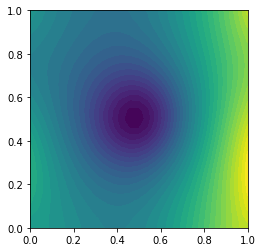

deg =  2
Solution vector norm (0): 48.638731383712376


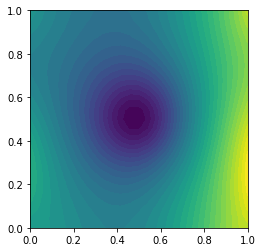

deg =  3
Solution vector norm (0): 62.7739057961875


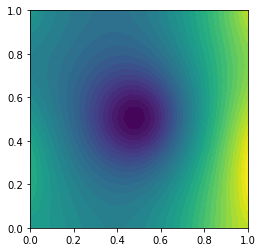

deg =  4
Solution vector norm (0): 76.870641649378


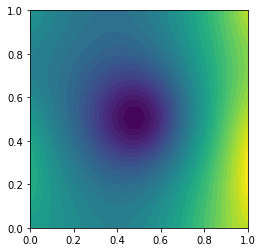

In [49]:
# DG 2D Poisson

"""This demo program solves Poisson's equation 2D

    - div grad u(x, y) = f(x, y)

on the unit square with source f given by

    f(x, y) = -100*exp(-((x - 0.5)^2 + (y - 0.5)^2)/0.02)

and boundary conditions given by

    u(x, y)     = u0 on x = 0 and x = 1
    du/dn(x, y) = g  on y = 0 and y = 1

where

    u0 = x + 0.25*sin(2*pi*x)
    g = (y - 0.5)**2

using a discontinuous Galerkin formulation (interior penalty method).
"""

# Copyright (C) 2007 Kristian B. Oelgaard
#
# This file is part of DOLFIN.
#
# DOLFIN is free software: you can redistribute it and/or modify
# it under the terms of the GNU Lesser General Public License as published by
# the Free Software Foundation, either version 3 of the License, or
# (at your option) any later version.
#
# DOLFIN is distributed in the hope that it will be useful,
# but WITHOUT ANY WARRANTY; without even the implied warranty of
# MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE. See the
# GNU Lesser General Public License for more details.
#
# You should have received a copy of the GNU Lesser General Public License
# along with DOLFIN. If not, see <http://www.gnu.org/licenses/>.

from dolfin import *
import matplotlib.pyplot as plt

# FIXME: Make mesh ghosted
parameters["ghost_mode"] = "shared_facet"

# Define class marking Dirichlet boundary (x = 0 or x = 1)
class DirichletBoundary(SubDomain):
  def inside(self, x, on_boundary):
    return on_boundary and near(x[0]*(1 - x[0]), 0)

# Define class marking Neumann boundary (y = 0 or y = 1)
class NeumanBoundary(SubDomain):
  def inside(self, x, on_boundary):
    return on_boundary and near(x[1]*(1 - x[1]), 0)

for deg in range(1,5):
    # Create mesh and define function space
    mesh  = UnitSquareMesh(24, 24)
    V     = FunctionSpace(mesh, 'DG', deg)

    # Define test and trial functions
    u     = TrialFunction(V)
    v     = TestFunction(V)

    # Define normal vector and mesh size
    n     = FacetNormal(mesh)
    h     = CellDiameter(mesh)
    h_avg = (h('+') + h('-'))/2

    # Define the source term f, Dirichlet term u0 and Neumann term g
    f = Expression('-100.0*exp(-(pow(x[0] - 0.5, 2) + pow(x[1] - 0.5, 2)) / 0.02)', degree = deg)
    u0 = Expression('x[0] + 0.25*sin(2*pi*x[1])', degree = deg)
    g = Expression('(x[1] - 0.5)*(x[1] - 0.5)', degree = deg)

    # Mark facets of the mesh
    boundaries = MeshFunction('size_t', mesh, mesh.topology().dim()-1) #https://fenicsproject.org/docs/dolfin/1.6.0/python/programmers-reference/cpp/mesh/MeshFunction.html
    DirichletBoundary().mark(boundaries, 1)
    NeumanBoundary().mark(boundaries, 2)

    # Define outer surface measure aware of Dirichlet and Neumann boundaries
    ds = Measure('ds', domain = mesh, subdomain_data = boundaries) 

    # Define parameters
    alpha = pow (abs (10*deg), 2) #4.0
    gamma = alpha #8.0

    # Define variational problem
    a = dot (grad (v), grad (u))*dx \
       - dot (jump (u, n), avg (grad (v)))*dS \
       - dot (jump (v, n), avg (grad (u)))*dS \
       + alpha/h_avg*dot(jump (v, n), jump (u, n))*dS \
       - dot (grad (v), u*n)*ds(1) \
       - dot (v*n, grad (u))*ds(1) \
       + (gamma/h)*v*u*ds (1)
    L = v*f*dx - u0*dot (grad (v), n)*ds (1) + (gamma/h)*u0*v*ds (1) + g*v*ds (2)

    # Compute solution
    u = Function(V)
    solve(a == L, u)
    print("deg = ", deg)
    print("Solution vector norm (0): {!r}".format(u.vector().norm("l2")))
    plt.figure (1, figsize = (8, 4))
    plot (u)
    
    # Hold plot
    plt.show () 




Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
Solution vector norm (0): 24.00751942424204


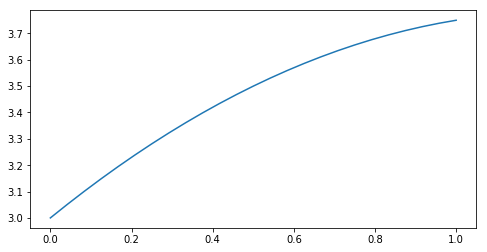

Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
Solution vector norm (0): 29.40358315660731


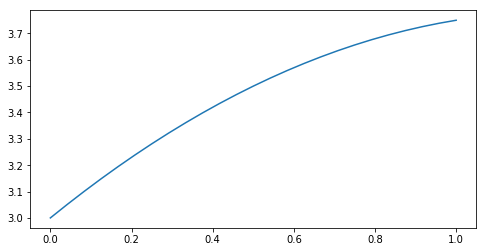

Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
Solution vector norm (0): 33.95252505752175


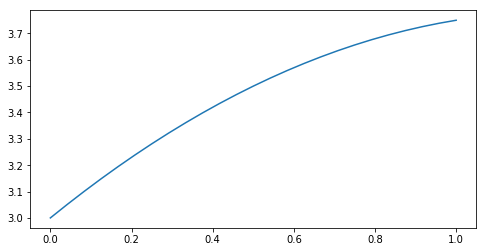

Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
Solution vector norm (0): 37.96018421313925


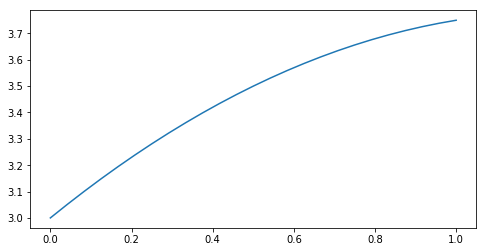

In [62]:
# DG 1D Poisson

"""This demo program solves Poisson's equation 2D

    - div grad u(x, y) = f(x, y)

on the unit square with source f given by

    f(x, y) = -100*exp(-((x - 0.5)^2 + (y - 0.5)^2)/0.02)

and boundary conditions given by

    u(x, y)     = u0 on x = 0 and x = 1
    du/dn(x, y) = g  on y = 0 and y = 1

where

    u0 = x + 0.25*sin(2*pi*x)
    g = (y - 0.5)**2

using a discontinuous Galerkin formulation (interior penalty method).
"""

# Copyright (C) 2007 Kristian B. Oelgaard
#
# This file is part of DOLFIN.
#
# DOLFIN is free software: you can redistribute it and/or modify
# it under the terms of the GNU Lesser General Public License as published by
# the Free Software Foundation, either version 3 of the License, or
# (at your option) any later version.
#
# DOLFIN is distributed in the hope that it will be useful,
# but WITHOUT ANY WARRANTY; without even the implied warranty of
# MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE. See the
# GNU Lesser General Public License for more details.
#
# You should have received a copy of the GNU Lesser General Public License
# along with DOLFIN. If not, see <http://www.gnu.org/licenses/>.

from dolfin import *

# FIXME: Make mesh ghosted
parameters["ghost_mode"] = "shared_facet"

# Define class marking Dirichlet boundary (x = 0 or x = 1)
class DirichletBoundary(SubDomain):
  def inside(self, x, on_boundary):
    return on_boundary and x[0] < DOLFIN_EPS


# Define class marking Neumann boundary (y = 0 or y = 1)
class NeumanBoundary(SubDomain):
  def inside(self, x, on_boundary):
    return on_boundary and x[0] > 1.0 - DOLFIN_EPS

for deg in range(1,5):
    # Create mesh and define function space
    mesh = UnitIntervalMesh(24)
    V = FunctionSpace(mesh, 'DG', deg)

    # Define test and trial functions
    u = TrialFunction(V)
    v = TestFunction(V)

    # Define normal vector and mesh size
    n = FacetNormal(mesh)
    h = CellDiameter(mesh)
    h_avg = (h('+') + h('-'))/2

    # Define the source term f, Dirichlet term u0 and Neumann term g
    f = Expression('1', degree = deg)
    u0 = Expression('3', degree = deg)
    g = Expression('(x[0] - 0.5)*(x[0] - 0.5)', degree=deg)

    # Mark facets of the mesh
    boundaries = MeshFunction('size_t', mesh, mesh.topology().dim()-1) #https://fenicsproject.org/docs/dolfin/1.6.0/python/programmers-reference/cpp/mesh/MeshFunction.html
    DirichletBoundary().mark(boundaries, 1)
    NeumanBoundary().mark(boundaries, 2)

    # Define outer surface measure aware of Dirichlet and Neumann boundaries
    ds = Measure('ds', domain = mesh, subdomain_data = boundaries)

    # Define parameters
    alpha = pow (abs (10*deg), 2) #4.0
    gamma = alpha #8.0

    # Define variational problem
    a = dot(grad(v), grad(u))*dx \
       - dot(avg(grad(v)), jump(u, n))*dS \
       - dot(jump(v, n), avg(grad(u)))*dS \
       + alpha/h_avg*dot(jump(v, n), jump(u, n))*dS \
       - dot(grad(v), u*n)*ds(1) \
       - dot(v*n, grad(u))*ds(1) \
       + (gamma/h)*v*u*ds(1)
    L = v*f*dx - u0*dot(grad(v), n)*ds(1) + (gamma/h)*u0*v*ds(1) + g*v*ds(2)

    # Compute solution
    u = Function(V)
    solve(a == L, u)
    print("Solution vector norm (0): {!r}".format(u.vector().norm("l2")))

    plt.figure (1, figsize = (8, 4))
    plot (u)
    
    # Hold plot
    plt.show ()


Solution vector norm (0): 63.72047012989159


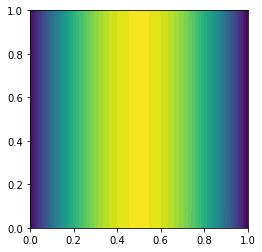

In [13]:
# DG 2D Poisson with constant f,g,u0

"""This demo program solves Poisson's equation 2D

    - div grad u(x, y) = f(x, y)

on the unit square with source f given by

    f(x, y) = -100*exp(-((x - 0.5)^2 + (y - 0.5)^2)/0.02)

and boundary conditions given by

    u(x, y)     = u0 on x = 0 and x = 1
    du/dn(x, y) = g  on y = 0 and y = 1

where

    u0 = x + 0.25*sin(2*pi*x)
    g = (y - 0.5)**2

using a discontinuous Galerkin formulation (interior penalty method).
"""

# Copyright (C) 2007 Kristian B. Oelgaard
#
# This file is part of DOLFIN.
#
# DOLFIN is free software: you can redistribute it and/or modify
# it under the terms of the GNU Lesser General Public License as published by
# the Free Software Foundation, either version 3 of the License, or
# (at your option) any later version.
#
# DOLFIN is distributed in the hope that it will be useful,
# but WITHOUT ANY WARRANTY; without even the implied warranty of
# MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE. See the
# GNU Lesser General Public License for more details.
#
# You should have received a copy of the GNU Lesser General Public License
# along with DOLFIN. If not, see <http://www.gnu.org/licenses/>.

from dolfin import *

# FIXME: Make mesh ghosted
parameters["ghost_mode"] = "shared_facet"

# Define class marking Dirichlet boundary (x = 0 or x = 1)
class DirichletBoundary(SubDomain):
  def inside(self, x, on_boundary):
    return on_boundary and near(x[0]*(1 - x[0]), 0)

# Create mesh and define function space
mesh = UnitSquareMesh(24, 24)

element = FiniteElement("Discontinuous Lagrange", "triangle", degree=1)
V       = FunctionSpace (mesh, element)

# Define test and trial functions
v = TestFunction(V)
u = TrialFunction(V)



# Define normal vector and mesh size
n = FacetNormal(mesh)
h = CellDiameter(mesh)
h_avg = (h('+') + h('-'))/2

# Define the source term f, Dirichlet term u0
f = Expression('1', degree=2)
u0 = Expression('1', degree=2)

# Mark facets of the mesh
boundaries = MeshFunction('size_t', mesh, mesh.topology().dim()-1, 0)
DirichletBoundary().mark(boundaries, 1)

# Define outer surface measure aware of Dirichlet and Neumann boundaries
ds = Measure('ds', domain = mesh, subdomain_data = boundaries)

# Define parameters
alpha = 4.0
gamma = 8.0

# Define variational problem
a = dot(grad(v), grad(u))*dx \
   - dot(avg(grad(v)), jump(u, n))*dS \
   - dot(jump(v, n), avg(grad(u)))*dS \
   + alpha/h_avg*dot(jump(v, n), jump(u, n))*dS \
   - dot(grad(v), u*n)*ds(1) \
   - dot(v*n, grad(u))*ds(1) \
   + (gamma/h)*v*u*ds(1)
L = v*f*dx - u0*dot(grad(v), n)*ds(1) + (gamma/h)*u0*v*ds(1)

# Compute solution
u = Function(V)
solve(a == L, u)
print("Solution vector norm (0): {!r}".format(u.vector().norm("l2")))
plot (u)


In [3]:
# DG Advection difussion linear

""" Steady state advection-diffusion equation,
discontinuous formulation using full upwinding.

Implemented in python from cpp demo by Johan Hake.
"""

# Copyright (C) 2008 Johan Hake
#
# This file is part of DOLFIN.
#
# DOLFIN is free software: you can redistribute it and/or modify
# it under the terms of the GNU Lesser General Public License as published by
# the Free Software Foundation, either version 3 of the License, or
# (at your option) any later version.
#
# DOLFIN is distributed in the hope that it will be useful,
# but WITHOUT ANY WARRANTY; without even the implied warranty of
# MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE. See the
# GNU Lesser General Public License for more details.
#
# You should have received a copy of the GNU Lesser General Public License
# along with DOLFIN. If not, see <http://www.gnu.org/licenses/>.
#
# First added:  2008-06-19
# Last changed: 2008-12-23

from dolfin import *
import matplotlib.pyplot as plt


# FIXME: Make mesh ghosted
parameters["ghost_mode"] = "shared_facet"

class DirichletBoundary(SubDomain):
    def inside(self, x, on_boundary):
        return abs(x[0] - 1.0) < DOLFIN_EPS and on_boundary

# Load mesh
mesh = UnitSquareMesh(24, 24)

# Defining the function spaces
V_dg = FunctionSpace(mesh, "DG", 1)
V_cg = FunctionSpace(mesh, "CG", 1)
V_u  = VectorFunctionSpace(mesh, "CG", 2)

# Create velocity Function
u = Function(V_u, "../unitsquare_64_64_velocity.xml.gz")

# Test and trial functions
v   = TestFunction(V_dg)
phi = TrialFunction(V_dg)

# Diffusivity
kappa = Constant(0.0)

# Source term
f = Constant(0.0)

# Penalty term
alpha = Constant(5.0)

# Mesh-related functions
n = FacetNormal(mesh)
h = CellDiameter(mesh)
h_avg = (h('+') + h('-'))/2

# ( dot(v, n) + |dot(v, n)| )/2.0
un = (dot(u, n) + abs(dot(u, n)))/2.0

# Bilinear form
a_int = dot(grad(v), kappa*grad(phi) - u*phi)*dx

a_fac = kappa*(alpha/h('+'))*dot(jump(v, n), jump(phi, n))*dS \
      - kappa*dot(avg(grad(v)), jump(phi, n))*dS \
      - kappa*dot(jump(v, n), avg(grad(phi)))*dS

a_vel = dot(jump(v), un('+')*phi('+') - un('-')*phi('-') )*dS  + dot(v, un*phi)*ds

a = a_int + a_fac + a_vel

# Linear form
L = v*f*dx

# Set up boundary condition (apply strong BCs)
g = Expression("sin(pi*5.0*x[1])", degree=2)
bc = DirichletBC(V_dg, g, DirichletBoundary(), "geometric")

# Solution function
phi_h = Function(V_dg)

# Assemble and apply boundary conditions
A = assemble(a)
b = assemble(L)
bc.apply(A, b)

# Solve system
solve(A, phi_h.vector(), b)

# Project solution to a continuous function space
up = project(phi_h, V=V_cg)

file = File("temperature.pvd")
file << up

# Plot solution
plot(up)
plt.show()

RuntimeError: 

*** -------------------------------------------------------------------------
*** DOLFIN encountered an error. If you are not able to resolve this issue
*** using the information listed below, you can ask for help at
***
***     fenics-support@googlegroups.com
***
*** Remember to include the error message listed below and, if possible,
*** include a *minimal* running example to reproduce the error.
***
*** -------------------------------------------------------------------------
*** Error:   Unable to read data from XML file.
*** Reason:  Unable to open file ".../unitsquare_64_64_velocity.xml.gz".
*** Where:   This error was encountered inside XMLFile.cpp.
*** Process: 0
*** 
*** DOLFIN version: 2019.1.0
*** Git changeset:  unknown
*** -------------------------------------------------------------------------


In [5]:
#Modifying
"""https://scicomp.stackexchange.com/questions/7420/discontinuous-galerkin-poisson-fenics"""

""" Steady state advection-diffusion equation,
discontinuous formulation using full upwinding.

Implemented in python from cpp demo by Johan Hake.
"""

from dolfin import *
import matplotlib.pyplot as plt

# FIXME: Make mesh ghosted
parameters["ghost_mode"] = "shared_facet"

class DirichletBoundary(SubDomain):
    def inside(self, x, on_boundary):
        return abs(x[0] - 1.0) < DOLFIN_EPS and on_boundary

# Load mesh
mesh = UnitSquareMesh(24, 24)

# Defining the function spaces
V_q      = VectorElement ('DG', mesh.ufl_cell(), degree=2)
V_T      = FiniteElement ('DG', mesh.ufl_cell(), degree=1)
element = MixedElement ([V_q, V_T])
W       = FunctionSpace (mesh, element)

# Define test and trial functions
(q, T) = TrialFunctions(W)
(w, v) = TestFunctions(W)

# Mesh-related functions
n = FacetNormal(mesh)
h = CellDiameter(mesh)
h_avg = (h('+') + h('-'))/2

# Source term
f = Constant(0.0)

# Diffusivity
kappa = Constant(0.0)

C11 = 1.
qhat = avg(grad(T)) - C11 * kappa*jump(T,n)
qhatbnd = grad(T) - C11 * kappa*T*n

a = dot(q,w)*dx + T*div(kappa*w)*dx \
  - kappa*avg(T)*jump(w,n)*dS \
  - kappa*T*dot(w,n)*ds \
  - dot(q,grad(v))*dx \
  + dot( qhat, jump(v,n))*dS \
  + dot( qhatbnd, v*n)*ds

# Linear form
L = v*f*dx



In [ ]:


# Diffusivity
kappa = Constant(0.0)

# Source term
f = Constant(0.0)

# Penalty term
alpha = Constant(5.0)

# Mesh-related functions
n = FacetNormal(mesh)
h = CellDiameter(mesh)
h_avg = (h('+') + h('-'))/2

# ( dot(v, n) + |dot(v, n)| )/2.0
un = (dot(u, n) + abs(dot(u, n)))/2.0

# Bilinear form
a_int = dot(grad(v), kappa*grad(phi) - u*phi)*dx

a_fac = kappa*(alpha/h('+'))*dot(jump(v, n), jump(phi, n))*dS \
      - kappa*dot(avg(grad(v)), jump(phi, n))*dS \
      - kappa*dot(jump(v, n), avg(grad(phi)))*dS

a_vel = dot(jump(v), un('+')*phi('+') - un('-')*phi('-') )*dS  + dot(v, un*phi)*ds

a = a_int + a_fac + a_vel





# Linear form
L = v*f*dx

# Set up boundary condition (apply strong BCs)
g = Expression("sin(pi*5.0*x[1])", degree=2)
bc = DirichletBC(V_dg, g, DirichletBoundary(), "geometric")

# Solution function
phi_h = Function(V_dg)

# Assemble and apply boundary conditions
A = assemble(a)
b = assemble(L)
bc.apply(A, b)

# Solve system
solve(A, phi_h.vector(), b)

# Project solution to a continuous function space
up = project(phi_h, V=V_cg)

file = File("temperature.pvd")
file << up

# Plot solution
plot(up)
plt.show()


In [ ]:
# SUPG CONVECTION-ADVECTION

https://bitbucket.org/fenics-project/dolfin/src/cca9a4d76bbd15801aaf965ac110d13d1fafa3c2/python/demo/undocumented/advection-diffusion/demo_advection-diffusion.py

# Busca FENICS DG
https://www.google.com/search?newwindow=1&sxsrf=ACYBGNTReM9YBgSwMhTbJTWRbvTrSkl4kQ%3A1570731311787&source=hp&ei=L3WfXf3tLcHB5OUP9Om7wAE&q=fenics+dg+disconinuous+galerkin&oq=fenics+dg+disconinuous+galerkin&gs_l=psy-ab.3...762.762..966...0.0..0.0.0.......0....2j1..gws-wiz.&ved=0ahUKEwi9wf-OppLlAhXBILkGHfT0DhgQ4dUDCAU&uact=5
    
    https://www.google.com/search?client=ubuntu&channel=fs&q=Steady+state+advection-diffusion+equation%2Cdiscontinuous+formulation+using+full+upwinding+dg+fenics+without+velocity+field&ie=utf-8&oe=utf-8
        
https://scicomp.stackexchange.com/questions/7420/discontinuous-galerkin-poisson-fenics    

In [5]:
"""This demo program solves Poisson's equation

    - div grad u(x, y) = f(x, y)

on the unit square with source f given by

    f(x, y) = 10*exp(-((x - 0.5)^2 + (y - 0.5)^2) / 0.02)

and boundary conditions given by

    u(x, y) = 0        for x = 0 or x = 1
du/dn(x, y) = sin(5*x) for y = 0 or y = 1
"""

# Copyright (C) 2007-2011 Anders Logg
#
# This file is part of DOLFIN.
#
# DOLFIN is free software: you can redistribute it and/or modify
# it under the terms of the GNU Lesser General Public License as published by
# the Free Software Foundation, either version 3 of the License, or
# (at your option) any later version.
#
# DOLFIN is distributed in the hope that it will be useful,
# but WITHOUT ANY WARRANTY; without even the implied warranty of
# MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE. See the
# GNU Lesser General Public License for more details.
#
# You should have received a copy of the GNU Lesser General Public License
# along with DOLFIN. If not, see <http://www.gnu.org/licenses/>.

# Begin demo



from dolfin import *
import math
parameters["form_compiler"]["representation"] = "uflacs"

def compute(nsteps, coordinate_degree, element_degree, gdim):
    # Create mesh and define function space

    print(nsteps)
    print(coordinate_degree)
    print(gdim)
    mesh = UnitDiscMesh.create(MPI.comm_world, nsteps, coordinate_degree, gdim)
    V = FunctionSpace(mesh, "Lagrange", element_degree)

    # Compute domain area and average h
    area = assemble(1.0*dx(mesh, degree=2))
    h = (area / mesh.num_cells())**(1.0 / mesh.topology().dim())

    # Define boundary condition
    u0 = Constant(0.0)
    bc = DirichletBC(V, u0, "on_boundary")

    # Define variational problem
    u = TrialFunction(V)
    v = TestFunction(V)
    f = Constant(1.0)
    a = inner(grad(u), grad(v))*dx(degree=3)
    L = f*v*dx(degree=3)

    # Compute solution
    u = Function(V)
    solve(a == L, u, bc)

    # Compute relative error norm
    x = SpatialCoordinate(mesh)
    uexact = (1.0 - x**2) / 4.0
    M = (u - uexact)**2*dx(degree=5)
    M0 = uexact**2*dx(degree=5)
    err = sqrt(assemble(M) / assemble(M0))

    return err, h, area, mesh.num_cells(), u

def compute_rates():
    "Compute convergence rates for degrees 1 and 2."
    gdim = 2
    tdim = gdim
    for coordinate_degree in (1, 2):
        for element_degree in (1, 2):
            print("\nUsing coordinate degree %d, element degree %d" % (coordinate_degree, element_degree))
            ufile = XDMFFile(MPI.comm_world, "poisson-disc-degree-x%d-e%d.xdmf" % (coordinate_degree, element_degree))
            encoding = XDMFFile.Encoding.HDF5 if has_hdf5() else XDMFFile.Encoding.ASCII
            preverr = None
            prevh = None
            for i, nsteps in enumerate((1, 8, 64)):
                err, h, area, num_cells, u = compute(nsteps, coordinate_degree, element_degree, gdim)
                if preverr is None:
                    conv = 0.0
                    print("conv =  N/A, h = %.3e, err = %.3e, area = %.16f, num_cells = %d" % (h, err, area, num_cells))
                else:
                    conv = math.log(preverr/err, prevh/h)
                    print("conv = %1.2f, h = %.3e, err = %.3e, area = %.16f, num_cells = %d" % (conv, h, err, area, num_cells))
                preverr = err
                prevh = h

                # Save solution to file
                u.rename('u', 'u')

                if MPI.size(MPI.comm_world) > 1 and encoding == XDMFFile.Encoding.ASCII:
                    print("XDMF file output not supported in parallel without HDF5")
                else:
                    ufile.write(u, encoding)

compute_rates()


Using coordinate degree 1, element degree 1
1
1
2
Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
conv =  N/A, h = 6.580e-01, err = 4.082e-01, area = 2.5980762113533169, num_cells = 6
8
1
2
conv = 1.94, h = 9.032e-02, err = 8.594e-03, area = 3.13262861328

In [2]:
""" This demo demonstrates the calculation and visualization of a TM
(Transverse Magnetic) cutoff mode of a rectangular waveguide.

For more information regarding waveguides see

http://www.ee.bilkent.edu.tr/~microwave/programs/magnetic/rect/info.htm

See the pdf in the parent folder and the following reference

The Finite Element in Electromagnetics (2nd Ed)
Jianming Jin [7.2.1 - 7.2.2]

"""
# Copyright (C) 2008 Evan Lezar
#
# This file is part of DOLFIN.
#
# DOLFIN is free software: you can redistribute it and/or modify
# it under the terms of the GNU Lesser General Public License as published by
# the Free Software Foundation, either version 3 of the License, or
# (at your option) any later version.
#
# DOLFIN is distributed in the hope that it will be useful,
# but WITHOUT ANY WARRANTY; without even the implied warranty of
# MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE. See the
# GNU Lesser General Public License for more details.
#
# You should have received a copy of the GNU Lesser General Public License
# along with DOLFIN. If not, see <http://www.gnu.org/licenses/>.
#
# Modified by Anders Logg 2008, 2015
#
# First added:  2008-08-22
# Last changed: 2015-06-15


from dolfin import *

# Test for PETSc and SLEPc
if not has_linear_algebra_backend("PETSc"):
    print("DOLFIN has not been configured with PETSc. Exiting.")
    exit()

if not has_slepc():
    print("DOLFIN has not been configured with SLEPc. Exiting.")
    exit()

# Make sure we use the PETSc backend
parameters["linear_algebra_backend"] = "PETSc"

# Create mesh
width = 1.0
height = 0.5
mesh = RectangleMesh(Point(0, 0), Point(width, height), 4, 2)

# Define the function space
V = FunctionSpace(mesh, "Nedelec 1st kind H(curl)", 3)

# Define the test and trial functions
v = TestFunction(V)
u = TrialFunction(V)

# Define the forms - generates an generalized eigenproblem of the form
# [S]{h} = k_o^2[T]{h}
# with the eigenvalues k_o^2 representing the square of the cutoff wavenumber
# and the corresponding right-eigenvector giving the coefficients of the
# discrete system used to obtain the approximate field anywhere in the domain
def curl_t(w):
    return Dx(w[1], 0) - Dx(w[0], 1)
s = curl_t(v)*curl_t(u)*dx
t = inner(v, u)*dx

# Assemble the stiffness matrix (S) and mass matrix (T)
S = PETScMatrix()
T = PETScMatrix()
assemble(s, tensor=S)
assemble(t, tensor=T)

# Solve the eigensystem
esolver = SLEPcEigenSolver(S, T)
esolver.parameters["spectrum"] = "smallest real"
esolver.parameters["solver"] = "lapack"
esolver.solve()

# The result should have real eigenvalues but due to rounding errors, some of
# the resultant eigenvalues may be small complex values.
# only consider the real part

# Now, the system contains a number of zero eigenvalues (near zero due to
# rounding) which are eigenvalues corresponding to the null-space of the curl
# operator and are a mathematical construct and do not represent physically
# realizable modes.  These are called spurious modes.
# So, we need to identify the smallest, non-zero eigenvalue of the system -
# which corresponds with cutoff wavenumber of the the dominant cutoff mode.
cutoff = None
for i in range(S.size(1)):
    (lr, lc) = esolver.get_eigenvalue(i)
    if lr > 1 and lc == 0:
        cutoff = sqrt(lr)
        break

if cutoff is None:
    print("Unable to find dominant mode")
else:
    print("Cutoff frequency:", cutoff)


Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
Cutoff frequency: 7.0253515495040215


In [ ]:
Multistage RKSolver() 